# Lab 2: Homography estimation and applications

In this lab you will learn how to estimate a homography relating two images given a set of correspondences between them. Then, you will work with different computer vision applications of the homography.

More precisely, the goals are:

1) Homography estimation with the DLT algorithm. <br>

2) Application: Image mosaics. <br>

3) Refinement of the estimated homography with the Gold Standard algorithm. <br>

4) Application: Camera calibration with a planar pattern and augmented reality. <br>

5) Application: Logo detection. <br>

6) Application: Logo replacement.

The following file combines some text cells (Markdown cells) and code cells. Some parts of the code need to be completed. All tasks you need to complete are marked in <span style='color:Green'> green.  </span>

In [ ]:
!pip install opencv-contrib-python==3.4.2.17

     |████████████████████████████████| 30.6 MB 3.8 MB/s 
You should consider upgrading via the '/opt/venv/bin/python -m pip install --upgrade pip' command.


In [2]:
import numpy as np
import cv2
import math
import sys
import matplotlib
from matplotlib import pyplot as plt
from operator import itemgetter
from utils import apply_H_fixed_image_size, plot_img, Ransac_DLT_homography

In [3]:
# utility functions

def get_kp_matches(imgA, imgB, descriptor='orb',distance_thr=0.85):

    if (descriptor=='sift'):
        descriptor = cv2.xfeatures2d.SIFT_create(nfeatures=500)
    elif (descriptor=='surf'):
        descriptor = cv2.xfeatures2d.SURF_create(hessianThreshold=600)
    else:
        descriptor = cv2.ORB_create()
    
    kpA, desA = descriptor.detectAndCompute(imgA,None)
    kpB, desB = descriptor.detectAndCompute(imgB,None)

    # Keypoint matching
    bf = cv2.BFMatcher()
    matches_AB = bf.knnMatch(desA,desB,k=2)
    # Apply ratio test
    good_matches_AB = []
    for m,n in matches_AB:
        if m.distance < distance_thr*n.distance:
            good_matches_AB.append([m])

    return kpA, kpB, good_matches_AB

def estimate_homography_inliers(kpA, kpB, good_matches_AB):
    pointsA = []
    pointsB = []
    for m in good_matches_AB:
        pointsA.append([kpA[m[0].queryIdx].pt[0], kpA[m[0].queryIdx].pt[1], 1])
        pointsB.append([kpB[m[0].trainIdx].pt[0], kpB[m[0].trainIdx].pt[1], 1])

    pointsA = np.asarray(pointsA)
    pointsA = pointsA.T
    pointsB = np.asarray(pointsB)
    pointsB = pointsB.T

    H_AB, indices_inlier_matches_AB = Ransac_DLT_homography(pointsA, pointsB, 3, 1000)
    
    return pointsA, pointsB, H_AB, indices_inlier_matches_AB

def show_images_matches(params):
    img_AB = cv2.drawMatchesKnn(*params,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    plt.imshow(img_AB)
    fig = matplotlib.pyplot.gcf()
    fig.set_size_inches(18.5, 10.5)
    plt.show()
    return

def create_mosaic(img1c, img2c, img3c, corners, H_12, H_23, output_filename='', save=False):
    img1c = cv2.cvtColor(img1c, cv2.COLOR_BGR2RGB)
    img2c = cv2.cvtColor(img2c, cv2.COLOR_BGR2RGB)
    img3c = cv2.cvtColor(img3c, cv2.COLOR_BGR2RGB)

    img1c_w = apply_H_fixed_image_size(img1c, H_12, corners)
    img2c_w = apply_H_fixed_image_size(img2c, np.eye(3), corners)
    img3c_w = apply_H_fixed_image_size(img3c, np.linalg.inv(H_23), corners)

    img_mosaic = np.maximum(img3c_w,np.maximum(img1c_w,img2c_w))
    plot_img(img_mosaic)
    fig = matplotlib.pyplot.gcf()
    fig.set_size_inches(18.5, 10.5)
    img_mosaic = cv2.cvtColor(img_mosaic, cv2.COLOR_RGB2BGR)
    
    if(save):
        cv2.imwrite(output_filename, img_mosaic)
    return

## **1. Homography estimation with the DLT algorithm**

### **1.1 Compute image correspondences**
Execute the following code to find image correspondences using ORB [1] (you may also use SIFT, SURF, etc)

[1] Ethan Rublee, Vincent Rabaud, Kurt Konolige, Gary R. Bradski: ORB: An efficient alternative to SIFT or SURF. ICCV 2011: 2564-2571.

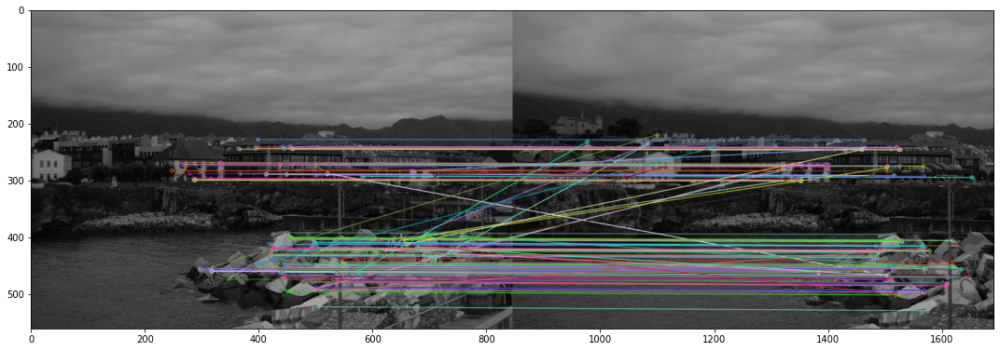

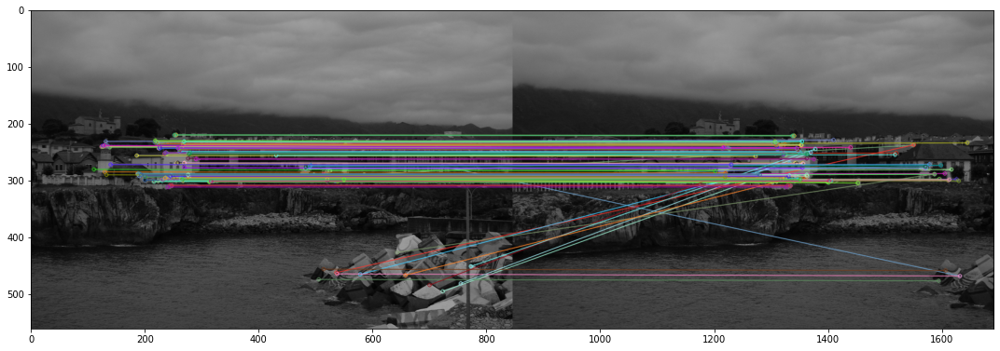

In [ ]:
# Read images
img1 = cv2.imread('Data/llanes/llanes_a.jpg',cv2.IMREAD_GRAYSCALE)
img2 = cv2.imread('Data/llanes/llanes_b.jpg',cv2.IMREAD_GRAYSCALE)
img3 = cv2.imread('Data/llanes/llanes_c.jpg',cv2.IMREAD_GRAYSCALE)

kp1, kp2, good_matches_12 = get_kp_matches(img1,img2,descriptor='orb')
_, kp3, good_matches_23 = get_kp_matches(img2,img3,descriptor='orb')

# Show "good" matches 
show_images_matches([img1,kp1,img2,kp2,good_matches_12])
show_images_matches([img2,kp2,img3,kp3,good_matches_23])

### **1.2 Compute the homography (DLT algorithm) between image pairs**

The following cell of code calls the 'Ransac_DLT_homography' function from utils.py
Before running the code of the cell you first need to complete some functions in utils.py that are called from 'Ransac_DLT_homography' function:

<span style='color:Green'> - Complete the 'DLT_homography' function that computes a homography from a set of point correspondences with the DLT algorithm.  </span>

<span style='color:Green'> - Complete the 'Inliers' function that, given a homography, a set of point correspondences and a certain threshold  returns the indices of the correspondences that are inliers.  </span>

<span style='color:Blue'> To complete this section we've implemented/completed the following functions: 'normalize_points', 'compute_A', 'DLT_homography' and 'Inliers', which can be found in the 'utils.py' file </span>

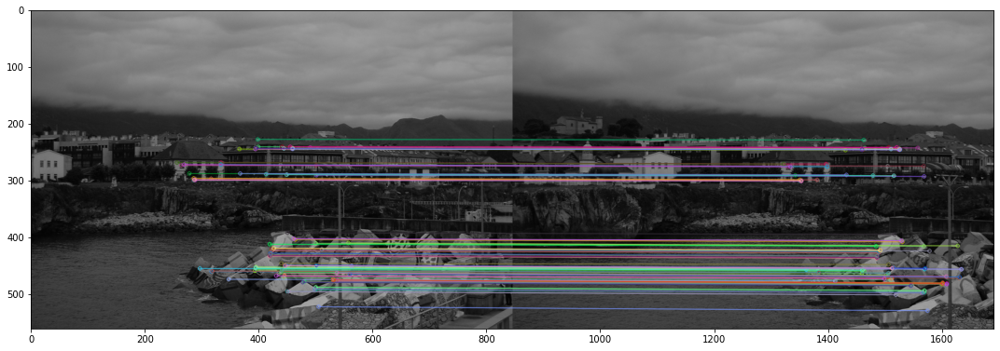

In [ ]:
# Homography between images 1 and 2
points1, points2, H_12, indices_inlier_matches_12 = estimate_homography_inliers(kp1,kp2,good_matches_12)
inlier_matches_12 = itemgetter(*indices_inlier_matches_12)(good_matches_12)

show_images_matches([img1,kp1,img2,kp2,inlier_matches_12])

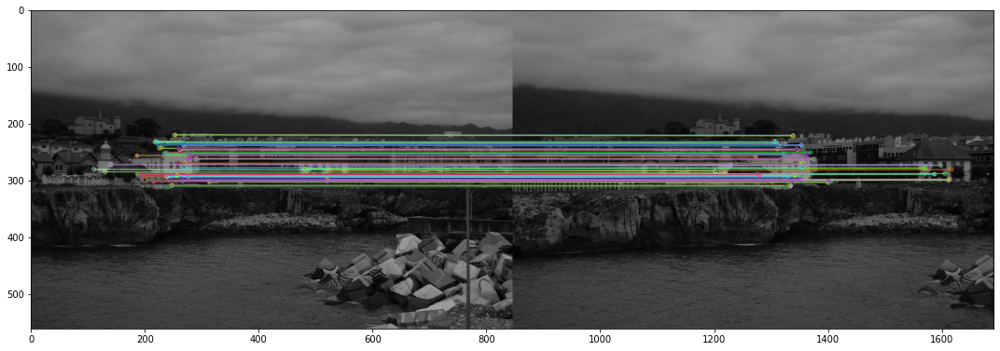

In [ ]:
# Homography between images 2 and 3
points2, points3, H_23, indices_inlier_matches_23 = estimate_homography_inliers(kp2,kp3,good_matches_23)
inlier_matches_23 = itemgetter(*indices_inlier_matches_23)(good_matches_23)

show_images_matches([img2,kp2,img3,kp3,inlier_matches_23])

## **2. Application: Image mosaics**

Now that the homographies relating the images have been estimated we can create a mosaic by properly transforming and fusing the different image contents.
For that we create a big enough canvas where the mosaic will be created. The function 'apply_H_fixed_image_size' is provided in utils.py, it is a variant of the 'apply_H' function from lab 1 where this time the size of the transformed is fixed and given as an extra input.

<span style='color:Green'> - Complete the 2nd input argument to the 'apply_H_fixed_image_size' function in order to get the image mosaic. </span>

#### 2a. Llanes

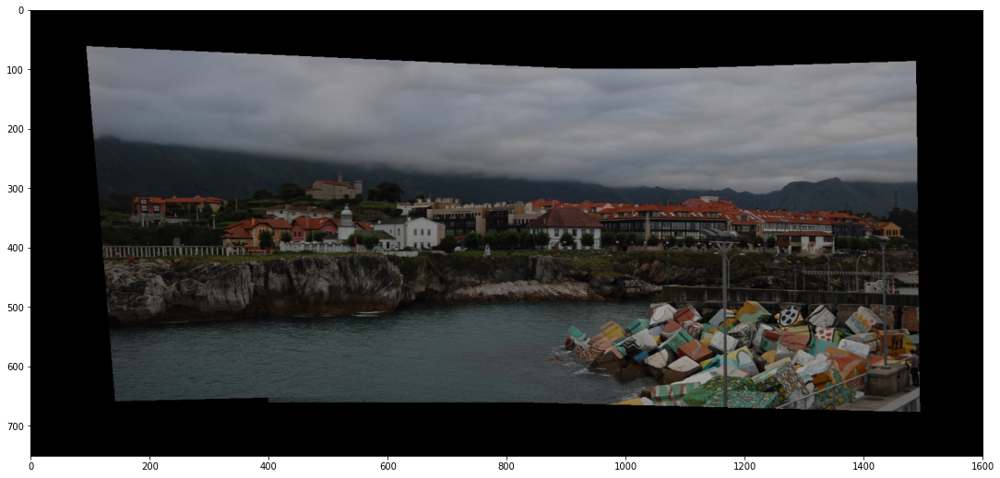

In [ ]:
corners = [-400, 1200, -100, 650] # corners of the canvas where the mosaic will be created

img1c = cv2.imread('Data/llanes/llanes_a.jpg',cv2.IMREAD_COLOR)
img2c = cv2.imread('Data/llanes/llanes_b.jpg',cv2.IMREAD_COLOR)
img3c = cv2.imread('Data/llanes/llanes_c.jpg',cv2.IMREAD_COLOR)

create_mosaic(img1c, img2c, img3c, corners, H_12, H_23, output_filename='mosaic_llanes.png', save=True)

<span style='color:Green'> - Compute the mosaic with castle_int images. </span>

#### 2b. Castle_int

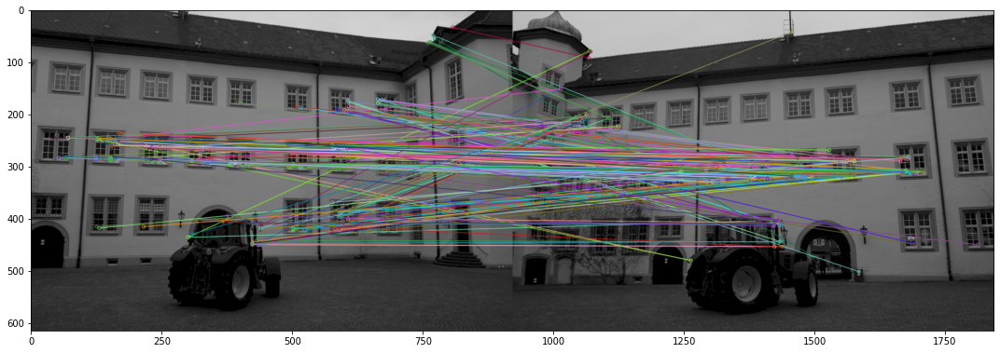

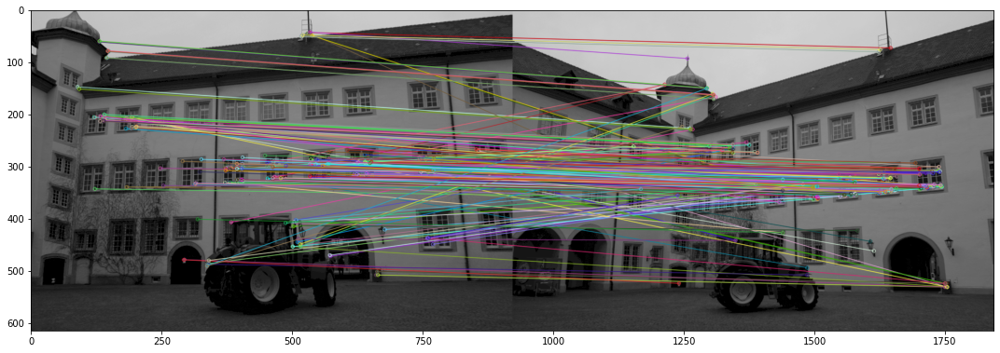

In [ ]:
# Read images
img1 = cv2.imread('Data/castle_int/0014_s.png',cv2.IMREAD_GRAYSCALE)
img2 = cv2.imread('Data/castle_int/0015_s.png',cv2.IMREAD_GRAYSCALE)
img3 = cv2.imread('Data/castle_int/0016_s.png',cv2.IMREAD_GRAYSCALE)

kp1, kp2, good_matches_12 = get_kp_matches(img1,img2,distance_thr=0.95)
_, kp3, good_matches_23 = get_kp_matches(img2,img3,distance_thr=0.95)

# Show "good" matches 
show_images_matches([img1,kp1,img2,kp2,good_matches_12])
show_images_matches([img2,kp2,img3,kp3,good_matches_23])

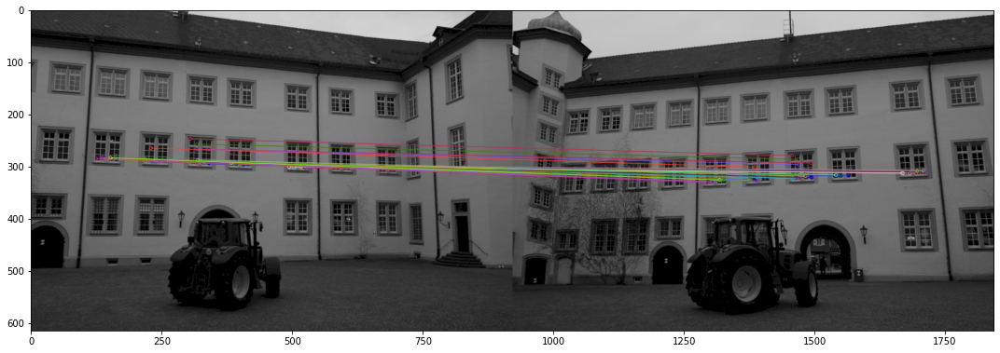

In [ ]:
# Homography between images 1 and 2
points1, points2, H_12, indices_inlier_matches_12 = estimate_homography_inliers(kp1,kp2,good_matches_12)
inlier_matches_12 = itemgetter(*indices_inlier_matches_12)(good_matches_12)

show_images_matches([img1,kp1,img2,kp2,inlier_matches_12])

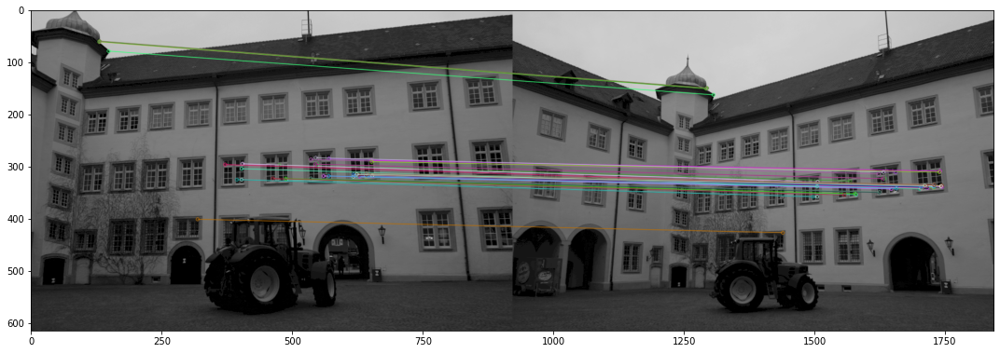

In [ ]:
# Homography between images 2 and 3
points2, points3, H_23, indices_inlier_matches_23 = estimate_homography_inliers(kp2,kp3,good_matches_23)
inlier_matches_23 = itemgetter(*indices_inlier_matches_23)(good_matches_23)

show_images_matches([img2,kp2,img3,kp3,inlier_matches_23])

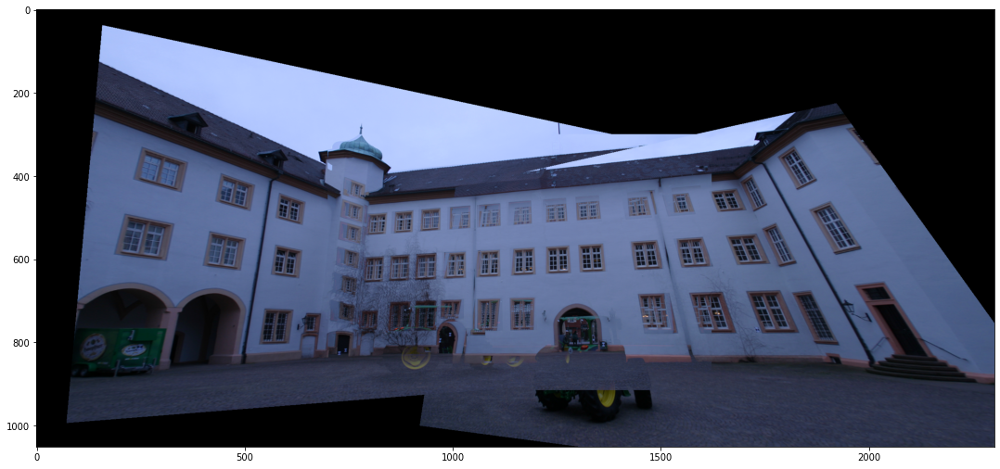

In [ ]:
corners = [-700, 1600, -300, 750]

img1c = cv2.imread('Data/castle_int/0014_s.png',cv2.IMREAD_COLOR)
img2c = cv2.imread('Data/castle_int/0015_s.png',cv2.IMREAD_COLOR)
img3c = cv2.imread('Data/castle_int/0016_s.png',cv2.IMREAD_COLOR)

create_mosaic(img1c, img2c, img3c, corners, H_12, H_23, output_filename='mosaic_castle_int.png', save=True)

<span style='color:Green'> - Compute the mosaic with aerial images set 13 </span>

#### 2c. Aerial/site13

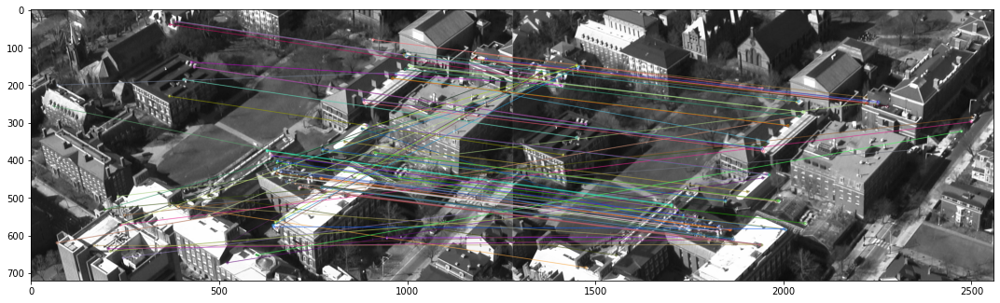

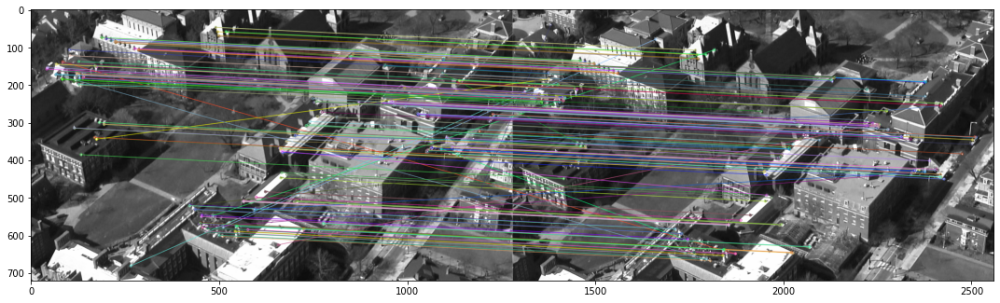

In [ ]:
# Read images
img1 = cv2.imread('Data/aerial/site13/frame00000.png',cv2.IMREAD_GRAYSCALE)
img2 = cv2.imread('Data/aerial/site13/frame00002.png',cv2.IMREAD_GRAYSCALE)
img3 = cv2.imread('Data/aerial/site13/frame00003.png',cv2.IMREAD_GRAYSCALE)

kp1, kp2, good_matches_12 = get_kp_matches(img1,img2)
_, kp3, good_matches_23 = get_kp_matches(img2,img3)

# Show "good" matches 
show_images_matches([img1,kp1,img2,kp2,good_matches_12])
show_images_matches([img2,kp2,img3,kp3,good_matches_23])

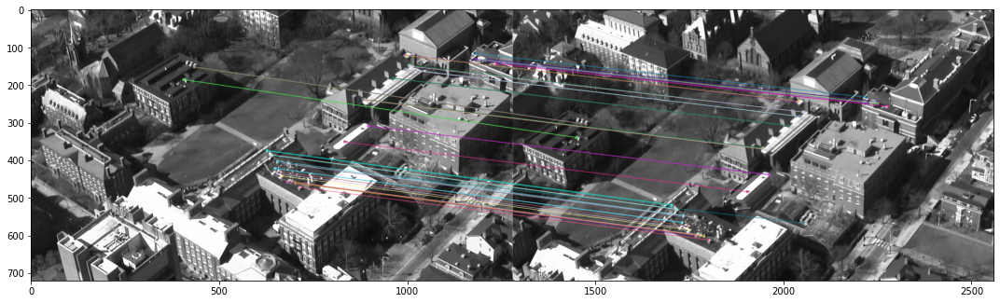

In [ ]:
# Homography between images 1 and 2
points1, points2, H_12, indices_inlier_matches_12 = estimate_homography_inliers(kp1,kp2,good_matches_12)
inlier_matches_12 = itemgetter(*indices_inlier_matches_12)(good_matches_12)

show_images_matches([img1,kp1,img2,kp2,inlier_matches_12])

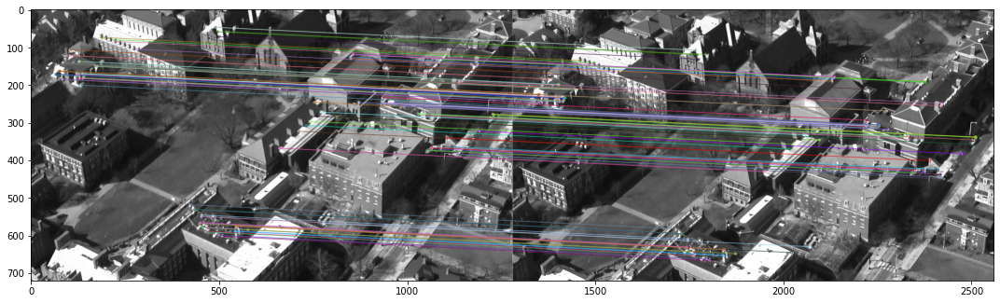

In [ ]:
# Homography between images 2 and 3
points2, points3, H_23, indices_inlier_matches_23 = estimate_homography_inliers(kp2,kp3,good_matches_23)
inlier_matches_23 = itemgetter(*indices_inlier_matches_23)(good_matches_23)

show_images_matches([img2,kp2,img3,kp3,inlier_matches_23])

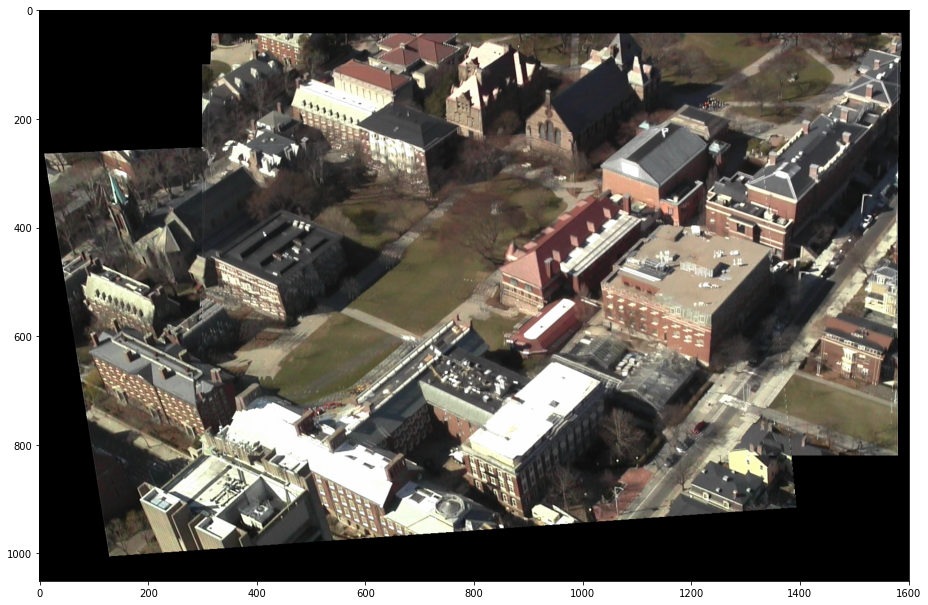

In [ ]:
corners = [-300, 1300, -100, 950] # corners of the canvas where the mosaic will be created

img1c = cv2.imread('Data/aerial/site13/frame00000.png',cv2.IMREAD_COLOR)
img2c = cv2.imread('Data/aerial/site13/frame00002.png',cv2.IMREAD_COLOR)
img3c = cv2.imread('Data/aerial/site13/frame00003.png',cv2.IMREAD_COLOR)

create_mosaic(img1c, img2c, img3c, corners, H_12, H_23, output_filename='mosaic_aerial_site13.png', save=True)

<span style='color:Green'> - Compute the mosaic with aerial images set 22 </span>

#### 2d. Aerial/site22

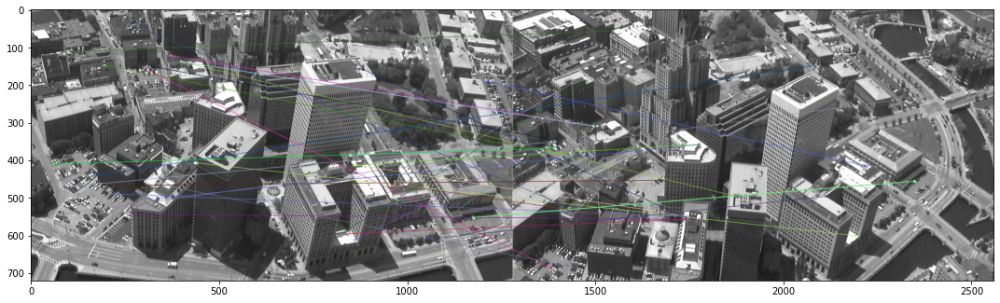

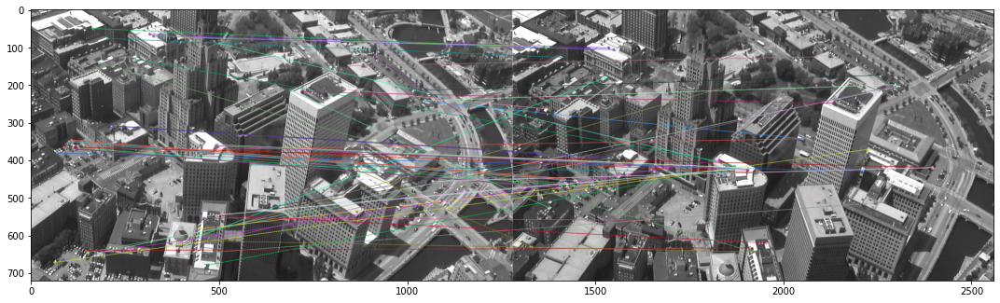

In [ ]:
# Read images
img1 = cv2.imread('Data/aerial/site22/frame_00001.tif',cv2.IMREAD_GRAYSCALE)
img2 = cv2.imread('Data/aerial/site22/frame_00018.tif',cv2.IMREAD_GRAYSCALE)
img3 = cv2.imread('Data/aerial/site22/frame_00030.tif',cv2.IMREAD_GRAYSCALE)

kp1, kp2, good_matches_12 = get_kp_matches(img1,img2)
_, kp3, good_matches_23 = get_kp_matches(img2,img3)

# Show "good" matches 
show_images_matches([img1,kp1,img2,kp2,good_matches_12])
show_images_matches([img2,kp2,img3,kp3,good_matches_23])

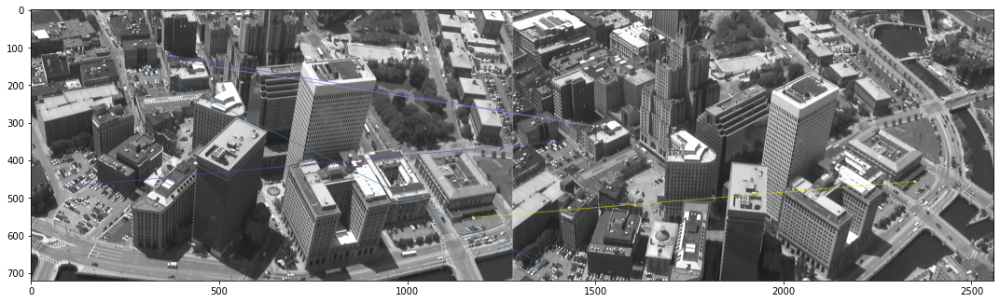

In [ ]:
# Homography between images 1 and 2
points1, points2, H_12, indices_inlier_matches_12 = estimate_homography_inliers(kp1,kp2,good_matches_12)
inlier_matches_12 = itemgetter(*indices_inlier_matches_12)(good_matches_12)

show_images_matches([img1,kp1,img2,kp2,inlier_matches_12])

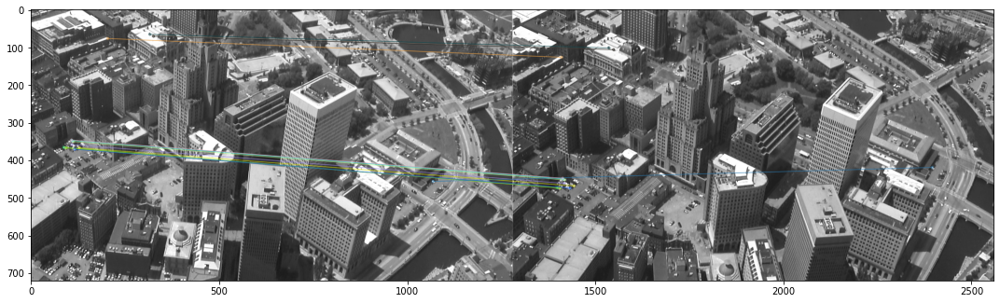

In [ ]:
# Homography between images 2 and 3
points2, points3, H_23, indices_inlier_matches_23 = estimate_homography_inliers(kp2,kp3,good_matches_23)
inlier_matches_23 = itemgetter(*indices_inlier_matches_23)(good_matches_23)

show_images_matches([img2,kp2,img3,kp3,inlier_matches_23])

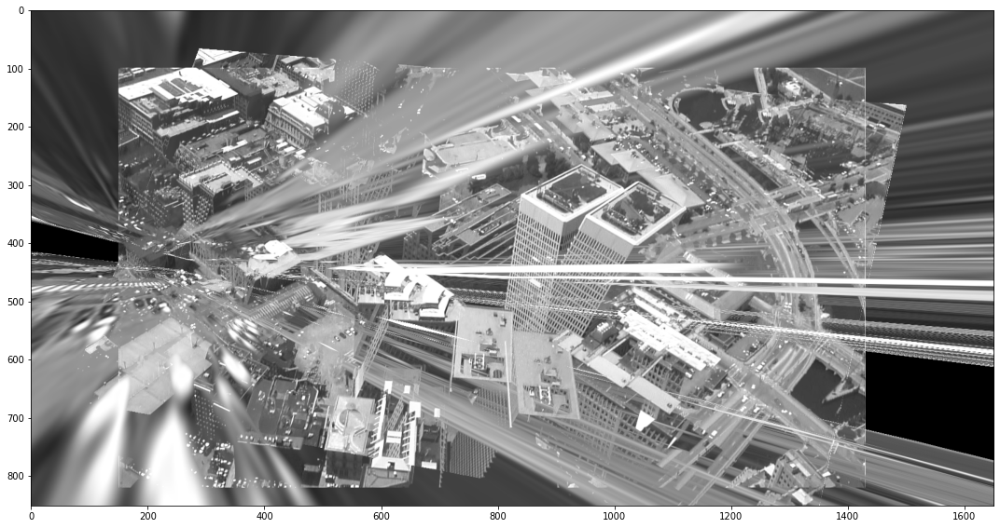

In [ ]:
corners = [-150, 1500, -100, 750] # corners of the canvas where the mosaic will be created

img1c = cv2.imread('Data/aerial/site22/frame_00001.tif',cv2.IMREAD_COLOR)
img2c = cv2.imread('Data/aerial/site22/frame_00018.tif',cv2.IMREAD_COLOR)
img3c = cv2.imread('Data/aerial/site22/frame_00030.tif',cv2.IMREAD_COLOR)

create_mosaic(img1c, img2c, img3c, corners, H_12, H_23, output_filename='mosaic_aerial_site22.png', save=True)

<span style='color:Green'> - In the report, comment the results in every of the four cases: hypothetise why it works or does not work </span>

## **3. Refinement of the estimated homography with the Gold Standard algorithm**

In order to refine the previous estimated homography we can minimize the geometric error with the Levenberg-Marquardt algorithm. For that we will call the function 'least_squares' with the proper input arguments that you have to complete. First, it is recommended to read the documentation of that function:

https://docs.scipy.org/doc/scipy/reference/generated/scipy.optimize.least_squares.html

Notice that the first input is a function that only provides the vector of the residuals. The algorithm constructs the cost function as a sum of squares of the residuals. In our case the function is called 'geometric_error_terms' and you need to complete it.

More precisely, the tasks to perform are:

<span style='color:Green'> - Complete the function 'geometric_error_terms'. </span>

In [ ]:
from scipy.optimize import least_squares

def geometric_error_terms(variables, data_points):

    # pointsA and pointsB are the points of images A and B, respectively, being
    # H the homography that projects pointsA to pointsB

    pointsA, pointsB = data_points

    # homography that projects pointsA to pointsB
    H = variables[:9].reshape(3,3)
    # initial guess of keypoint locations, can be computed with: np.linalg.inv(H) @ pointsB
    pointsA_h = variables[9:].reshape(2,-1)
    
    pointsA_h_hom = np.vstack([pointsA_h, np.ones(shape=(1,pointsA_h.shape[1]))])
    
    # project pointsA to the image B
    pointsB_h = H @ pointsA_h_hom
    pointsB_h = pointsB_h/pointsB_h[2,:]
    pointsB_h = pointsB_h[:2,:]

    # compute the vector of residuals as the reprojection error (without squaring the terms, as 
    # the function 'least squares' constructs the cost function as a sum of squares of the residuals)
    err1 = (pointsA-pointsA_h)
    err2 = (pointsB-pointsB_h)
    return np.concatenate([err1.flatten(),err2.flatten()])

<span style='color:Blue'> We're going to refine the homographies H_12 and H_23 of the images castle_int. First, we compute again the keypoints and estimate the homography H_12: </span>

In [ ]:
# Read images
img1 = cv2.imread('Data/castle_int/0014_s.png',cv2.IMREAD_GRAYSCALE)
img2 = cv2.imread('Data/castle_int/0015_s.png',cv2.IMREAD_GRAYSCALE)
img3 = cv2.imread('Data/castle_int/0016_s.png',cv2.IMREAD_GRAYSCALE)

kp1, kp2, good_matches_12 = get_kp_matches(img1,img2,distance_thr=0.95)
_, kp3, good_matches_23 = get_kp_matches(img2,img3,distance_thr=0.95)

# Homography between images 1 and 2
points1, points2, H_12, indices_inlier_matches_12 = estimate_homography_inliers(kp1,kp2,good_matches_12)
inlier_matches_12 = itemgetter(*indices_inlier_matches_12)(good_matches_12)

<span style='color:Blue'> Then, we refine H_12 using the function 'least_squares' </span>

<span style='color:Green'> - Complete the code before calling function 'geometric_error_terms' in order to create the proper input of variables, 'variables0', to pass to the function. </span>

In [ ]:
# inlier keypoints from images 1 and 2
points1_inl = points1[:,indices_inlier_matches_12]
points2_inl = points2[:,indices_inlier_matches_12]

# initial guess of the keypoint locations
points1_h = np.linalg.inv(H_12) @ points2_inl

# we want to refine the homography H and the keypoint locations
variables0 = np.concatenate([H_12.flatten(), points1_h[:2,:].flatten()])

# data points: argument of the function 'geometric_error_terms'
points = [points1_inl[:2,:], points2_inl[:2,:]]

result = least_squares(geometric_error_terms, variables0, method='lm', args=([points]))

<span style='color:Green'> - Extract the refined homogaphy and the refined keypoint locations from the output, 'result', of function 'geometric_error_terms'.  </span>

In [ ]:
H_12_ref = result.x[:9].reshape(3,3)
points1_ref = result.x[9:].reshape(2,-1)

<span style='color:Green'> - To better compare the two homographies (refined and non refined) compute and print the geometric error before and after the refinement. </span>

In [ ]:
# geometric error before the refinement:
variables_non_ref = np.concatenate([H_12.flatten(), points1_h[:2,:].flatten()])
err_non_ref = geometric_error_terms(variables_non_ref, points)
# function 'geometric_error_terms' returns a vector of residuals, and we want to represent 
# the geometric error as a sum of squares of the residuals
err_non_ref = np.sum(err_non_ref**2)

# geometric error after the refinement:
variables_ref = np.concatenate([H_12_ref.flatten(), points1_ref[:2,:].flatten()])
err_ref = geometric_error_terms(variables_ref, points)
err_ref = np.sum(err_ref**2)

print(f'Geometric error before the refinement: {err_non_ref:.2f}')
print(f'Geometric error after the refinement: {err_ref:.2f}')

Geometric error before the refinement: 8963534.88
Geometric error after the refinement: 16.84


<span style='color:Blue'> Now that we've refined the homography and keypoint locations of images 1-2, we're going to do the same for images 2-3: </span>

In [ ]:
# Homography between images 2 and 3
points2, points3, H_23, indices_inlier_matches_23 = estimate_homography_inliers(kp2,kp3,good_matches_23)
inlier_matches_23 = itemgetter(*indices_inlier_matches_23)(good_matches_23)

In [ ]:
# inlier keypoints from images 2 and 3
points2_inl = points2[:,indices_inlier_matches_23]
points3_inl = points3[:,indices_inlier_matches_23]

# initial guess of the keypoint locations
points2_h = np.linalg.inv(H_23) @ points3_inl

# we want to refine the homography H and the keypoint locations
variables0 = np.concatenate([H_23.flatten(), points2_h[:2,:].flatten()])

# data points: argument of the function 'geometric_error_terms'
points = [points2_inl[:2,:], points3_inl[:2,:]]

result = least_squares(geometric_error_terms, variables0, method='lm', args=([points]))

In [ ]:
# refined homography and keypoints locations
H_23_ref = result.x[:9].reshape(3,3)
points2_ref = result.x[9:].reshape(2,-1)

# geometric error before the refinement:
variables_non_ref = np.concatenate([H_23.flatten(), points2_h[:2,:].flatten()])
err_non_ref = geometric_error_terms(variables_non_ref, points)
err_non_ref = np.sum(err_non_ref**2)

# geometric error after the refinement:
variables_ref = np.concatenate([H_23_ref.flatten(), points2_ref[:2,:].flatten()])
err_ref = geometric_error_terms(variables_ref, points)
err_ref = np.sum(err_ref**2)

print(f'Geometric error before the refinement: {err_non_ref:.2f}')
print(f'Geometric error after the refinement: {err_ref:.2f}')

Geometric error before the refinement: 43022747.26
Geometric error after the refinement: 27.77


<span style='color:Blue'> Finally we show the non refined and refined keypoint locations of images 1-2 and 2-3: </span>

<span style='color:Green'> - Refine the homography 23 with the Gold Standard algorithm and visualize the differences in the keypoint locations. </span>

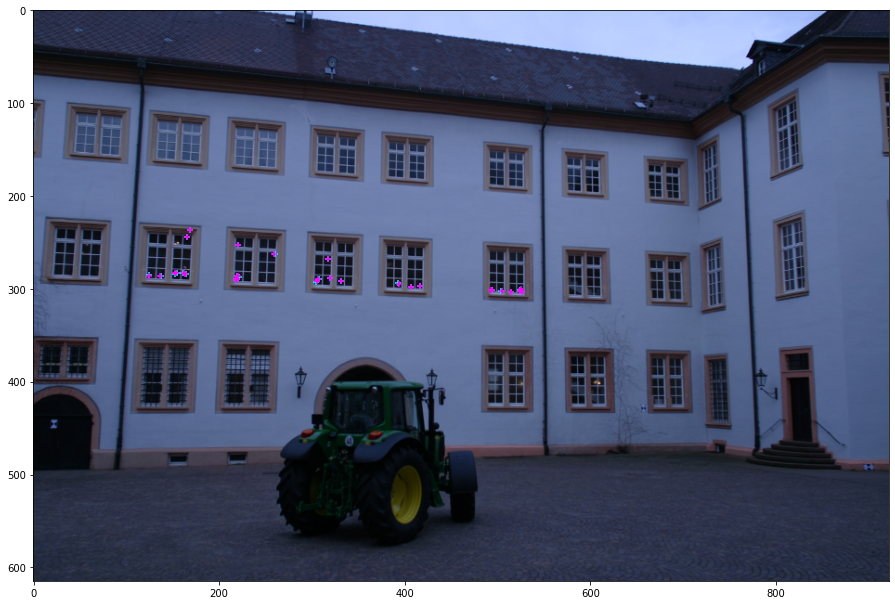

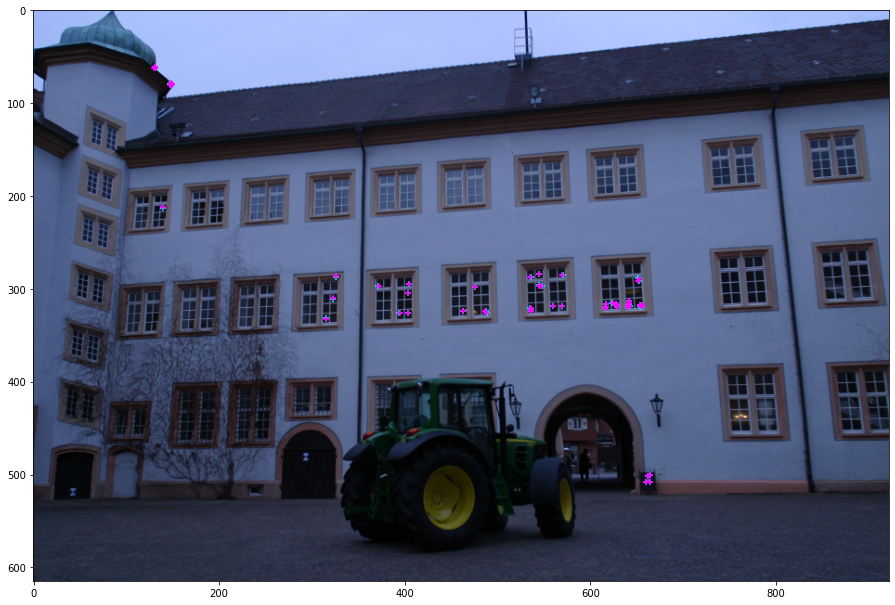

In [ ]:
# display points and refined points
def show_points_refined(imgA, pointsA, pointsA_ref):
    imgA = cv2.cvtColor(imgA, cv2.COLOR_BGR2RGB)
    fig, ax = plt.subplots()
    ax.imshow(imgA)
    ax.scatter(pointsA[0,:],pointsA[1,:], c='cyan', marker='+')
    ax.scatter(pointsA_ref[0,:],pointsA_ref[1,:], c='fuchsia', marker='+')
    fig = matplotlib.pyplot.gcf()
    fig.set_size_inches(18.5, 10.5)
    plt.show()
    return

img1c = cv2.imread('Data/castle_int/0014_s.png',cv2.IMREAD_COLOR)
img2c = cv2.imread('Data/castle_int/0015_s.png',cv2.IMREAD_COLOR)
img3c = cv2.imread('Data/castle_int/0016_s.png',cv2.IMREAD_COLOR)

show_points_refined(img1c, points1_inl, points1_ref)
show_points_refined(img2c, points2_inl, points2_ref)

<span style='color:Green'> - Build mosaic with the refined homographies. </span>

# <span style='color:Blue'> ???? LA IMATGE AQUESTA ÉS MOLT INESTABLE, CADA VEGADA QUE EXECUTES TOT I CALCULES LA HOMOGRAFIA EL RESULTAT ÉS DIFERENT (PER SORT A L'APARTAT 1. S'HA FET BÉ......." </span>

Before refinement:
After refinement:


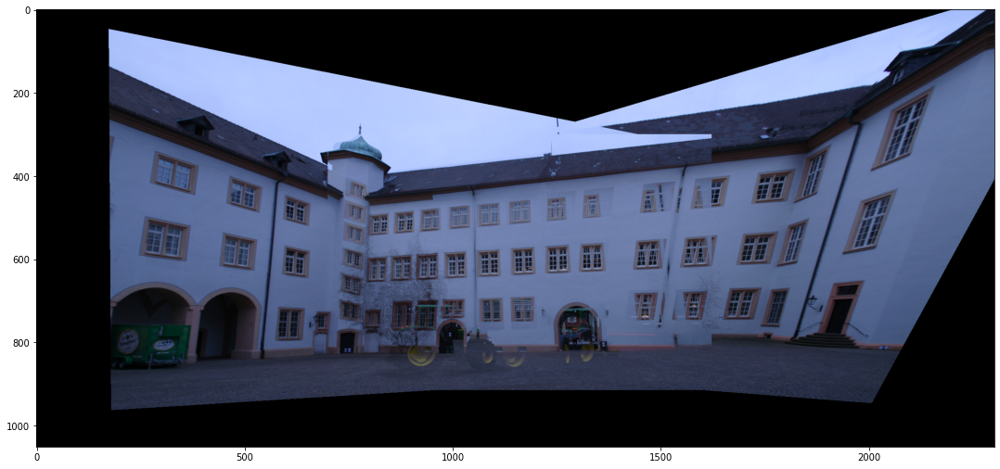

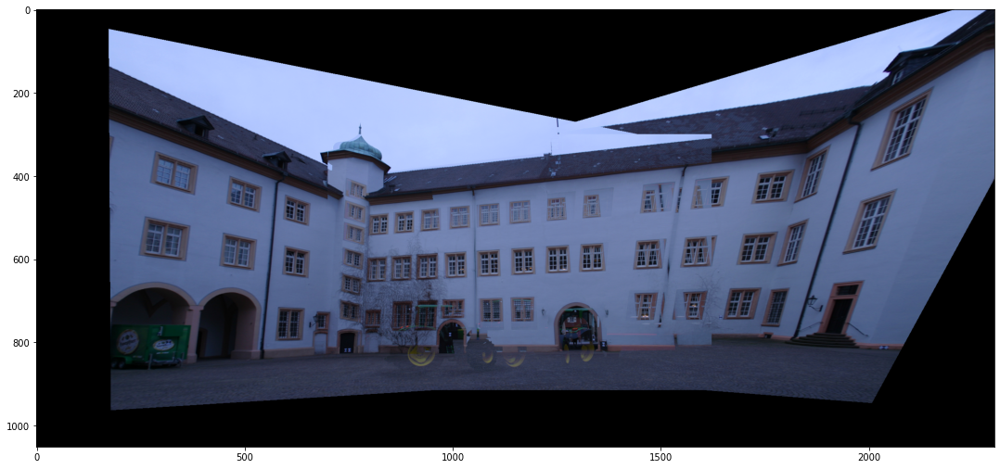

In [ ]:
corners = [-700, 1600, -300, 750]

print('Before refinement:')
create_mosaic(img1c, img2c, img3c, corners, H_12, H_23)
print('After refinement:')
create_mosaic(img1c, img2c, img3c, corners, H_12_ref, H_23_ref)

## **4. OPTIONAL. Application: Calibration with a planar pattern and augmented reality**

As we have seen in class, we can calibrate a camera with a planar pattern with Zhang's algorithm. A key aspect of this algorithm is the estimation of a homography that relates a pair of images, in particular, the template image and an image of it taken with the camera we want to calibrate. Once the camera is calibrated and we have recovered the relative pose between the camera and the planar pattern we can properly insert a virtual object on top of the flat pattern in a way that it is consistent, in a perspective sense, with rest of the scene.

### **4.1 Camera calibration**

The following code calibrates a camera using N (where N greater or equal than three) views of the planar pattern. Most of the code is provided but there are parts you need to complete. These parts are indicated in green before the corresponding cell code.


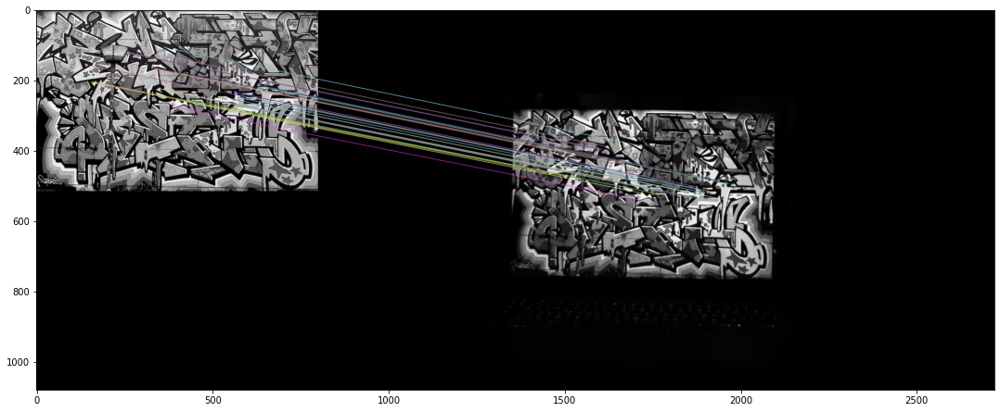

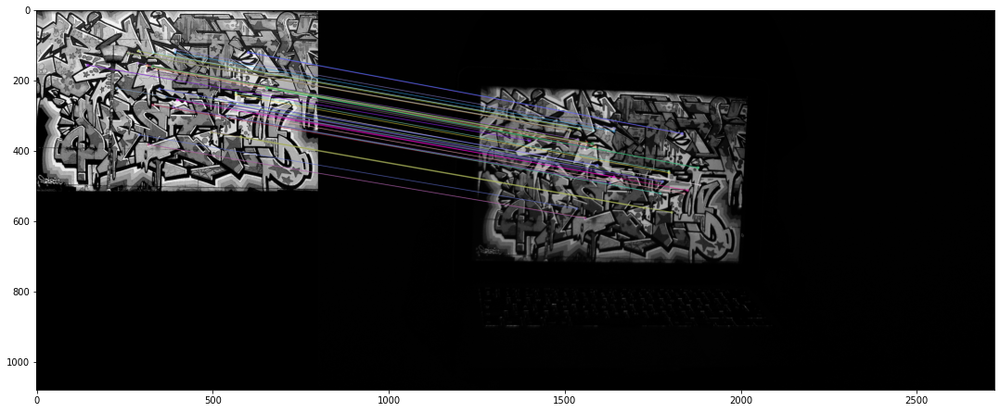

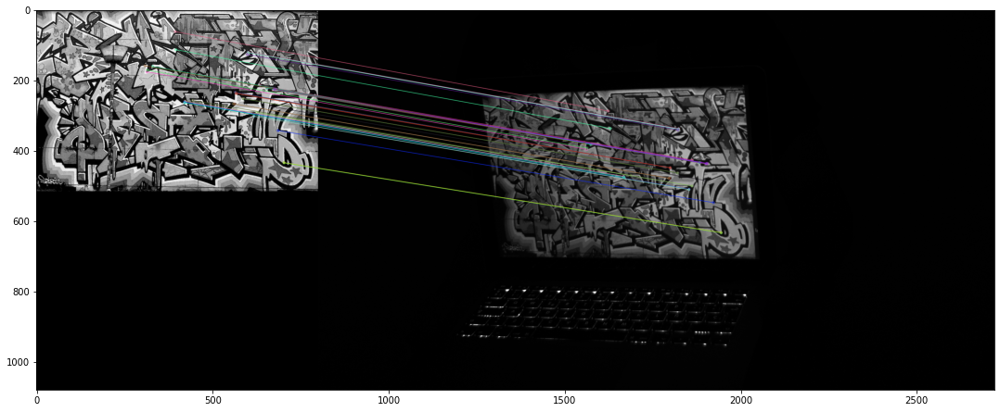

In [4]:
# Read template image and calibration images
template = cv2.imread('Data/calib/template.jpg',cv2.IMREAD_GRAYSCALE)
images = []
N = 3 # 3, 4, or 5
for i in range(1,N+1):
    m = cv2.imread("Data/calib/graffiti{0}.tif".format(i),cv2.IMREAD_GRAYSCALE)
    images.append(m)

# Initiate ORB detector
orb = cv2.ORB_create()
# find the keypoints and descriptors with ORB
kpt, dest = orb.detectAndCompute(template,None)
kpi, desi = [], []
for m in images:
    kp, des = orb.detectAndCompute(m,None)
    kpi.append(kp)
    desi.append(des)

# Keypoint matching and homography estimation
bf = cv2.BFMatcher()
H = []
for i in range(N):
    matches = bf.knnMatch(dest,desi[i],k=2)
    # Apply ratio test
    good_matches = []
    for m,n in matches:
        if m.distance < 0.85*n.distance:
            good_matches.append([m])
    
    # Fit homography and remove outliers
    points1 = []
    points2 = []
    for m in good_matches:
        points1.append([kpt[m[0].queryIdx].pt[0], kpt[m[0].queryIdx].pt[1], 1])
        points2.append([kpi[i][m[0].trainIdx].pt[0], kpi[i][m[0].trainIdx].pt[1], 1])
    
    points1 = np.asarray(points1)
    points1 = points1.T
    points2 = np.asarray(points2)
    points2 = points2.T
    
    Hi, indices_inlier_matches = Ransac_DLT_homography(points1, points2, 3, 1000)
    H.append(Hi)
    
    # Show inlier matches
    inlier_matches = itemgetter(*indices_inlier_matches)(good_matches)
    img_12 = cv2.drawMatchesKnn(template,kpt,images[i],kpi[i],inlier_matches,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    plt.imshow(img_12)
    fig = matplotlib.pyplot.gcf()
    fig.set_size_inches(18.5, 10.5)
    plt.show()


<span style='color:Green'> - Complete the code that computes the Image of the Absolute Conic. </span>

In [5]:
# being hi the column i of the homography matrix
def vij(hi,hj):
    return np.array([[hi[0]*hj[0], 
                      hi[0]*hj[1] + hi[1]*hj[0], 
                      hi[0]*hj[2] + hi[2]*hj[0], 
                      hi[1]*hj[1], 
                      hi[1]*hj[2] + hi[2]*hj[1],
                      hi[2]*hj[2]]])

V = np.empty(shape=(2*N, 6))

# we compute 2 equations for each view of the planar pattern
for i in range(N):
    Hi = H[i]
    
    h1 = Hi[:,0]
    h2 = Hi[:,1]
    h3 = Hi[:,2]

    v12 = vij(h1,h2)
    v11 = vij(h1,h1)
    v22 = vij(h2,h2)

    V[2*i, :] = v12
    V[2*i+1, :] = (v11-v22)

U,D,UT = np.linalg.svd(V)

# the function 'numpy.linalg.svd' returns the last matrix (UT) transposed, so omega (the singular vector
# associated to the smallest singular value) is the last row (and not column) of UT
omega = UT[-1,:]

# image of the Absolut Conic
w = np.array([[omega[0], omega[1], omega[2]], 
              [omega[1], omega[3], omega[4]],
              [omega[2], omega[4], omega[5]]])

print(f'w:\n{w}')

w:
[[ 1.55147267e-07  3.76027686e-10 -1.51706645e-04]
 [ 3.76027686e-10  1.50571831e-07 -5.12905108e-05]
 [-1.51706645e-04 -5.12905108e-05  9.99999987e-01]]


<span style='color:Green'> - Complete the code that computes the matrix of internal parameters, K. </span>

Note: there is a linalg.cholesky function both in numpy and scipy, you have to read the documentation of both and find out which is the proper one to use here.

<span style='color:Blue'> The scipy function returns an upper triangular matrix decomposition, in contrast to numpy which returns a lower triangular matrix. 
As the K parameter matrix is an upper triangular matrix, we will be using the scipy function. </span>

In [8]:
import scipy.linalg

# note that the cholesky decomposition returns A = M^t*M, but the image of the Absolut
# Conic w = K^(-t)*K^(-1), so we need to invert the result of scipy.linalg.cholesky(w)
Kinv = scipy.linalg.cholesky(w)
K = np.linalg.inv(Kinv)

print(f'K:\n{K}')

K:
[[ 2.53879676e+03 -6.24604545e+00  1.06954691e+03]
 [ 0.00000000e+00  2.57708918e+03  3.70232836e+02]
 [ 0.00000000e+00  0.00000000e+00  1.09472131e+00]]


<span style='color:Green'> - In the report, make some comments related to the obtained internal camera parameters and also comment their relation to the image size. </span>

<span style='color:Green'> - Complete the calculation of r1, r2, and ti in the code below. </span>

In [9]:
# Compute camera position and orientation
import math
R = []
t = []
P = []

for i in range(N):
    # compute r1, r2, and t{i}
    h = H[i]
    r1 = Kinv @ h[:,0]
    r2 = Kinv @ h[:,1]
    ti = Kinv @ h[:,2]
    
    # Solve the scale ambiguity by forcing r1 and r2 to be unit vectors.
    s = math.sqrt(np.linalg.norm(r1) * np.linalg.norm(r2)) * np.sign(ti[2])
    r1 = r1 / s
    r2 = r2 / s
    ti = ti / s
    t.append(ti)
    Ri = np.array([r1, r2, np.cross(r1,r2)])
    Ri = Ri.T
    
    # Ensure R is a rotation matrix
    U, d, Vt = np.linalg.svd(Ri)
    Ri = U @ np.identity(3) @ Vt
    R.append(Ri)
   
    # Pi = K * [Ri ti]
    A = np.zeros((3,4))
    A[:3,:3] = Ri
    A[:,3] = ti
    Pi = K @ A
    P.append(Pi)

The following code (no need to be completed) draws the planar pattern and the N camera locations (position and orientation).

<span style='color:Green'> - Take a look to the provided code for that and in the report explain how the optical center is computed. </span>

In [10]:
import plotly.graph_objects as go
from utils import plot_camera, plot_image_origin

ny, nx = images[0].shape

fig = go.Figure()
for i in range(N):
    plot_camera(P[i], nx, ny, fig, "camera{0}".format(i))

plot_image_origin(nx, ny, fig, "image")

fig.show()

Alternatively, we can draw a fixed camera and N planar patterns at different relative poses with respect to the camera.

<span style='color:Green'> -Complete the function ' plot_image_Rt' in order to achieve that. Note: it may be useful to look at function 'plot_image_origin' in utils.py</span>

In [ ]:
def plot_image_Rt(R,t,w, h, fig, legend):
    # we rotate and translate the x,y,z corners of each image with the corresponding extrinsics R,t
    Rt = np.column_stack([R, t])
    p1 = Rt @ np.array([0, 0, 0, 1])
    p2 = Rt @ np.array([w, 0, 0, 1])
    p3 = Rt @ np.array([w, h, 0, 1])
    p4 = Rt @ np.array([0, h, 0, 1])

    x = np.array([p1[0], p2[0], p3[0], p4[0], p1[0]])
    y = np.array([p1[1], p2[1], p3[1], p4[1], p1[1]])
    z = np.array([p1[2], p2[2], p3[2], p4[2], p1[2]])

    fig.add_trace(go.Scatter3d(x=x, y=z, z=-y, mode='lines',name=legend))
    
    return

fig = go.Figure()
A = np.zeros((3,4))
A[0,0]=A[1,1]=A[2,2]=1

plot_camera(K@A, nx, ny, fig, "camera")
for i in range(N):
    plot_image_Rt(R[i], t[i], nx, ny, fig, "image{0}".format(i))

fig.show()

### **4.2 Augmented reality**

The following code (no need to be completed) draws a simple 3D virtual object (a cube) on top of the flat pattern.

<span style='color:Green'> - Analyse the provided code and in the report explain how the virtual object is inserted in the image and why the camera view needs to be calibrated. </span>

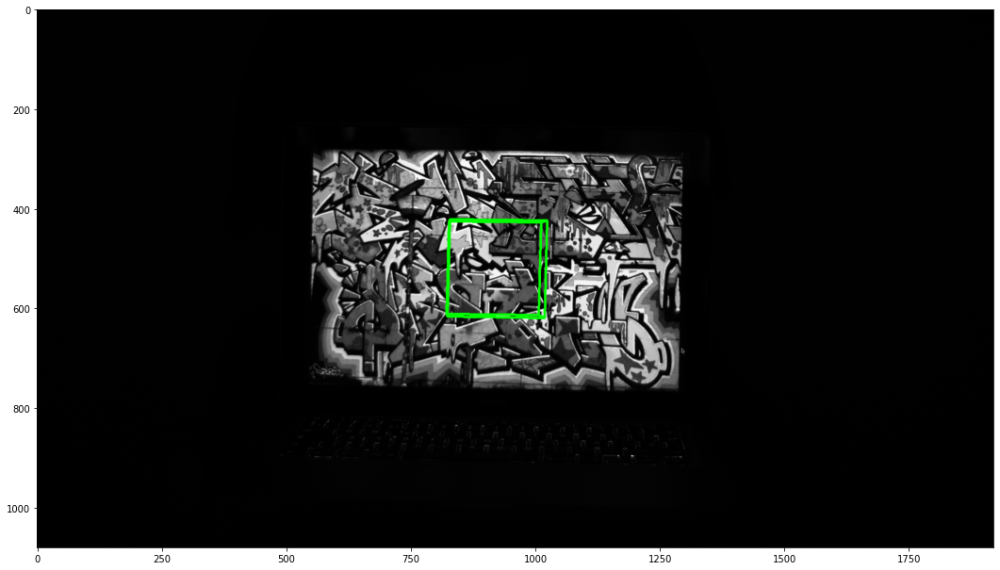

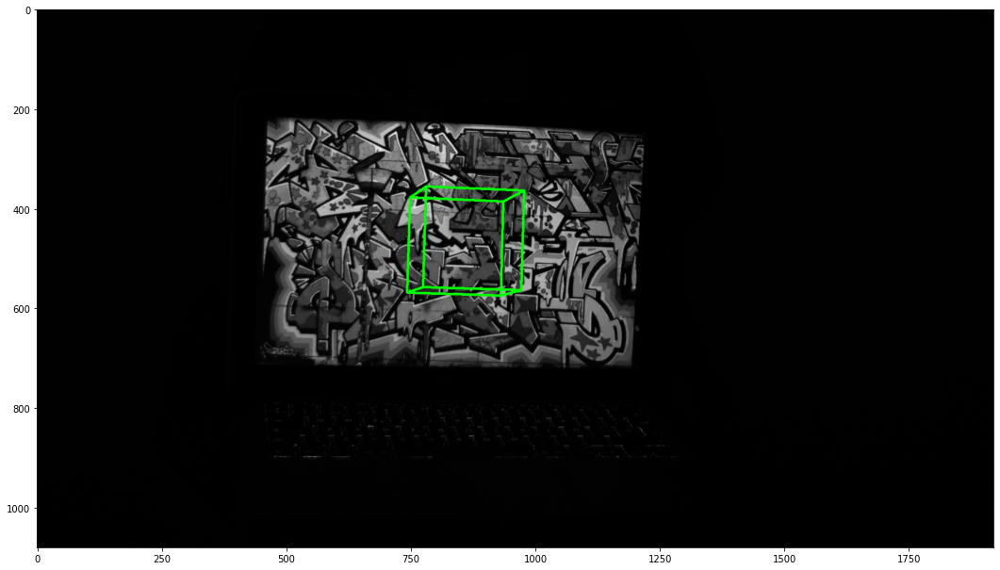

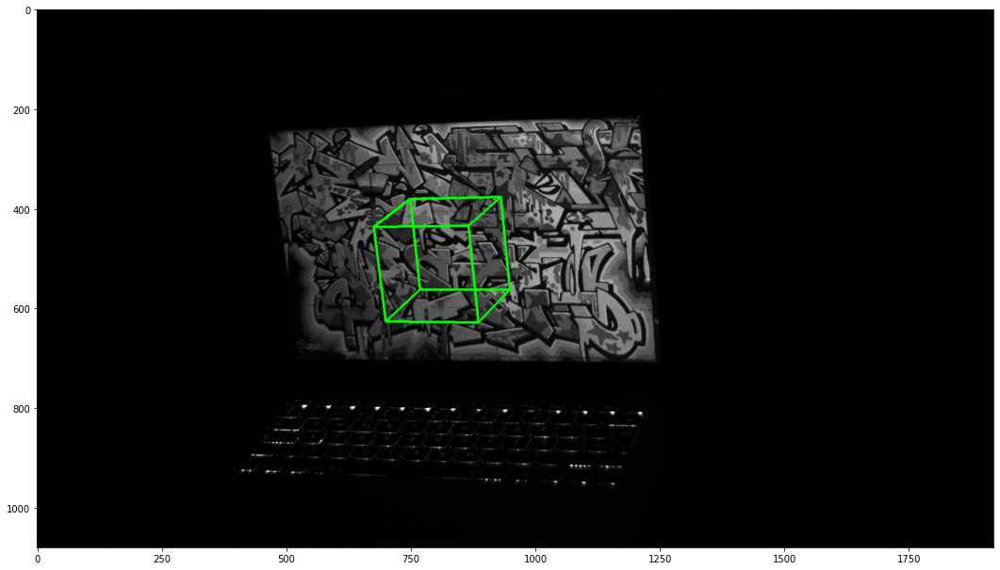

In [ ]:
Th, Tw = template.shape
cube_corners = np.array(
    [[0, 0, 0], [1, 0, 0], [1, 1, 0], [0, 1, 0], 
    [0, 0, 0], [0, 0, 1], [1, 0, 1], [1, 1, 1], 
    [0, 1, 1], [0, 0, 1], [0, 0, 0], [1, 0, 0], 
    [1, 0, 1], [0, 0, 1], [0, 0, 0], [0, 1, 0], 
    [1, 1, 0], [1, 1, 1], [0, 1, 1], [0, 1, 0]])

import numpy.matlib
offset = np.array([Tw/2, Th/2, -Tw/8])
M = cube_corners.shape[0]
X = (cube_corners - 0.5) * Tw/ 4 + np.matlib.repmat(offset, M, 1)

X = X.T
ones = np.ones(M)
Xh = np.stack((X[0,:], X[1,:], X[2,:], ones), axis=0)

line_color = (0, 255, 0)

for i in range(N):
    
    xp = P[i]@Xh
    xp = xp / xp[2,:]
    xp = xp.astype(int)
    
    image = cv2.imread("Data/calib/graffiti{0}.tif".format(i+1),cv2.IMREAD_COLOR)
    image_gray = image
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    image_gray[:, :, 0] = gray[:, :]
    image_gray[:, :, 1] = image_gray[:, :, 0]
    image_gray[:, :, 2] = image_gray[:, :, 0]
    for j in range(M-1):
        image = cv2.line(image_gray, (xp[0,j],xp[1,j]), (xp[0,j+1],xp[1,j+1]), line_color, 4) 
    plt.imshow(image)
    fig = matplotlib.pyplot.gcf()
    fig.set_size_inches(18.5, 10.5)
    plt.show()


## **5. OPTIONAL. Application: Logo detection**

<span style='color:Green'> - Detect the UPF logo in the two UPF images using the DLT algorithm (folder "logos").
Interpret and comment the results. </span>

<span style='color:Blue'> In this section we present logo detection with manual selection of the four corners of the logo in the target image (5a-b) and automatic logo detection (5c-d)  </span>

#### 5a - Manually selecting the four corners in the target image (UPF building)

<span style='color:Blue'> Knowing the size of the image 'logoUPF' and the (manually selected) corners of the upf logo in the building image we have 4 correspondences between both images, so we can estimate the homography that relates them with the normalized DLT algorithm  </span>

In [ ]:
from utils import DLT_homography

upf_logo = cv2.imread('Data/logos/logoUPF.png',cv2.IMREAD_GRAYSCALE)
upf_building = cv2.imread('Data/logos/UPFbuilding.jpg',cv2.IMREAD_GRAYSCALE)

# using the size of the image 'logoUPF'
h,w = upf_logo.shape
corners_logo_img = np.array([[0,w,w,0], 
                             [0,0,h,h], 
                             [1,1,1,1]])

# manually selected corners of the upf logo in the building image
corners_logo_building = np.array([[316, 423, 417, 306], 
                                  [52, 66, 143, 130],
                                  [1, 1, 1, 1]])
# we can estimate the homography using the 4 correspondences
H_building_manual = DLT_homography(corners_logo_img, corners_logo_building)

<span style='color:Blue'> To "detect" the logo we can project the corners of the image 'logoUPF' using the estimated homography: </span>

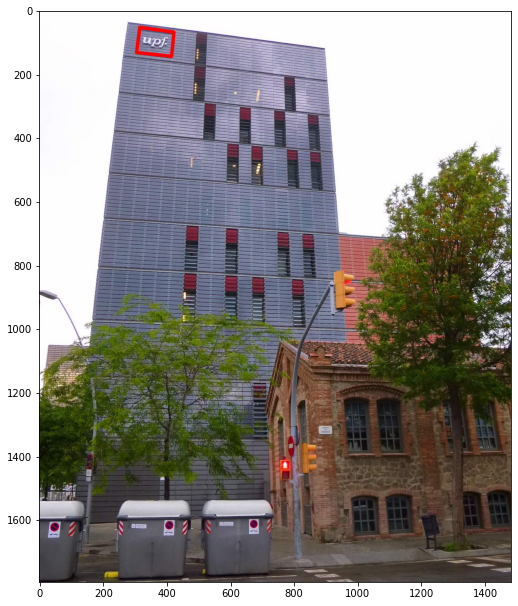

In [ ]:
# estimated corners of the upf logo in the building image
corners_logo_building_h = H_building_manual @ corners_logo_img
corners_logo_building_h = np.transpose(corners_logo_building_h[:2,:]/corners_logo_building_h[2,:])

upf_building_c = cv2.imread('Data/logos/UPFbuilding.jpg',cv2.IMREAD_COLOR)
upf_building_c = cv2.cvtColor(upf_building_c, cv2.COLOR_BGR2RGB)

upf_building_c_detected = cv2.polylines(np.copy(upf_building_c), 
                                        [corners_logo_building_h.reshape(-1,1,2).astype('int32')], 
                                        isClosed=True, color=(255,0,0), thickness=10)
plot_img(upf_building_c_detected)
fig = matplotlib.pyplot.gcf()
fig.set_size_inches(18.5, 10.5)

<span style='color:Blue'> Finally, we create a mosaic to "insert" the image 'logoUPF' on the building image </span>

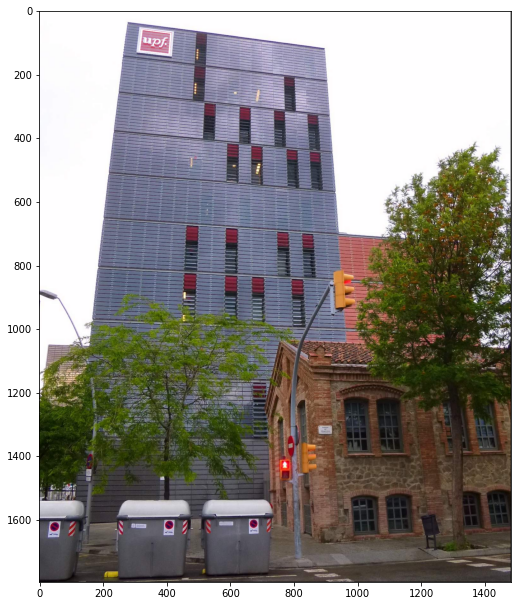

In [ ]:
def create_mosaic_logo(imgA, imgB, H, corners):
    imgA_w = apply_H_fixed_image_size(imgA, H, corners)
    imgB_w = apply_H_fixed_image_size(imgB, np.eye(3), corners)

    img_mosaic = np.maximum(imgA_w,imgB_w)
    plot_img(img_mosaic)
    fig = matplotlib.pyplot.gcf()
    fig.set_size_inches(18.5, 10.5)
    img_mosaic = cv2.cvtColor(img_mosaic, cv2.COLOR_RGB2BGR)

upf_logo_c = cv2.imread('Data/logos/logoUPF.png',cv2.IMREAD_COLOR)
upf_logo_c = cv2.cvtColor(upf_logo_c, cv2.COLOR_BGR2RGB)

# corners of the canvas where the mosaic will be created
corners_canvas = [0, upf_building_c.shape[1], 0, upf_building_c.shape[0]]

create_mosaic_logo(upf_logo_c, upf_building_c, H_building_manual, corners_canvas)

<span style='color:Blue'> Here, we manually selected the exact pixels that correspond to the corners of the upf logo in the building image and used this correspondences to estimate the homography H. In a different scenario, maybe we only have approximate guesses of these corners, so the correspondences may not be accurate enough to precisely estimate H. One way to approach this problem would be to compute keypoints in both images but restricting the region of the building image to the inside of these approximate guesses of the corners. Then, using these keypoints, we could estimate H using RANSAC and DLT. This case is presented below for the building image, where we define the corners of the upf logo wrongly (but close to the correct ones):  </span>

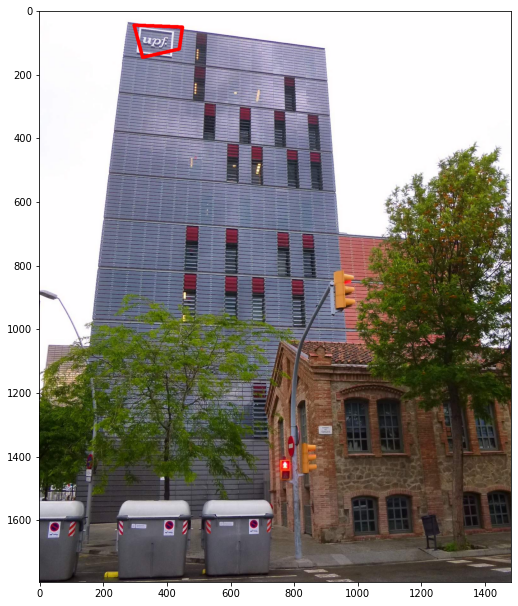

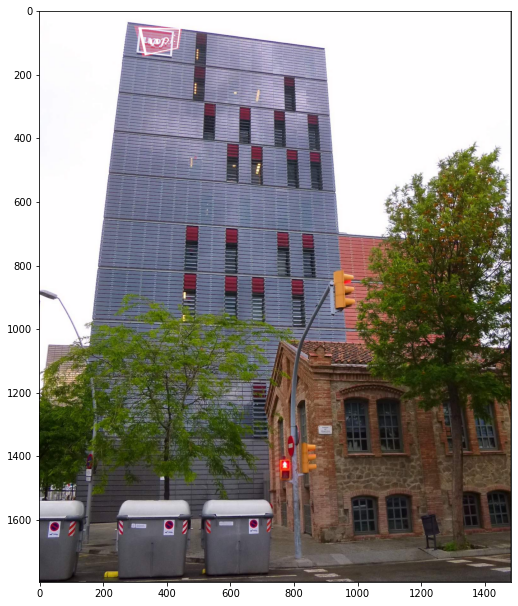

In [ ]:
# WRONGLY (but close) manually selected corners of the upf logo in the building image
corners_logo_building_wrong = np.array([[298, 451, 440, 325], 
                                        [45, 51, 119, 145],
                                        [1, 1, 1, 1]])

# these are the correct ones: np.array([[316, 423, 417, 306], 
#                                       [52, 66, 143, 130],
#                                       [1, 1, 1, 1]])

# if we estimate the homography using these 4 correspondences, the result is not satisfactory
H_building_wrong = DLT_homography(corners_logo_img, corners_logo_building_wrong)

# estimated corners of the upf logo in the building image
corners_logo_building_h_wrong = H_building_wrong @ corners_logo_img
corners_logo_building_h_wrong = np.transpose(corners_logo_building_h_wrong[:2,:]/corners_logo_building_h_wrong[2,:])

upf_building_c_detected_wrong = cv2.polylines(np.copy(upf_building_c), 
                                             [corners_logo_building_h_wrong.reshape(-1,1,2).astype('int32')], 
                                             isClosed=True, color=(255,0,0), thickness=10)

plot_img(upf_building_c_detected_wrong)
fig = matplotlib.pyplot.gcf()
fig.set_size_inches(18.5, 10.5)

create_mosaic_logo(upf_logo_c, upf_building_c, H_building_wrong, corners_canvas)

<span style='color:Blue'> The results are not good, so let's try it with keypoints and RANSAC+DLT. Notice that we cannot compute keypoints of the whole building image, because the matches will be wrong (as the upf logo in the building image is too small): </span>

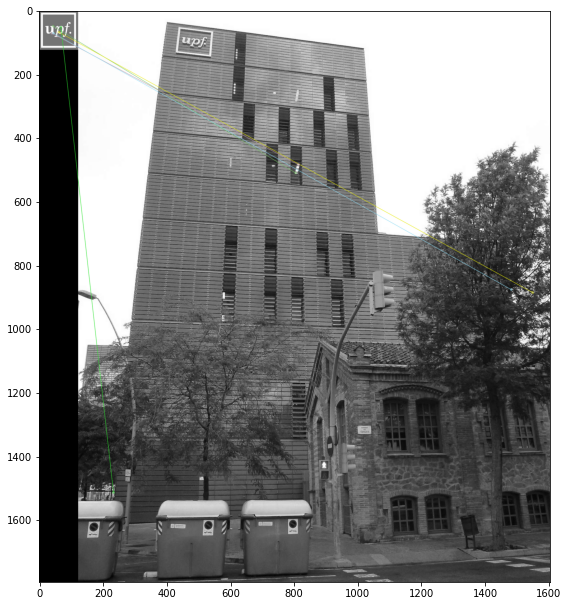

In [ ]:
kp_logo, kp_building, wrong_matches_logo_building = get_kp_matches(upf_logo,upf_building)

show_images_matches([upf_logo,kp_logo,upf_building,kp_building,wrong_matches_logo_building])

<span style='color:Blue'> For this reason, we use the approximate corners to define a region in which to compute the keypoints: </span>

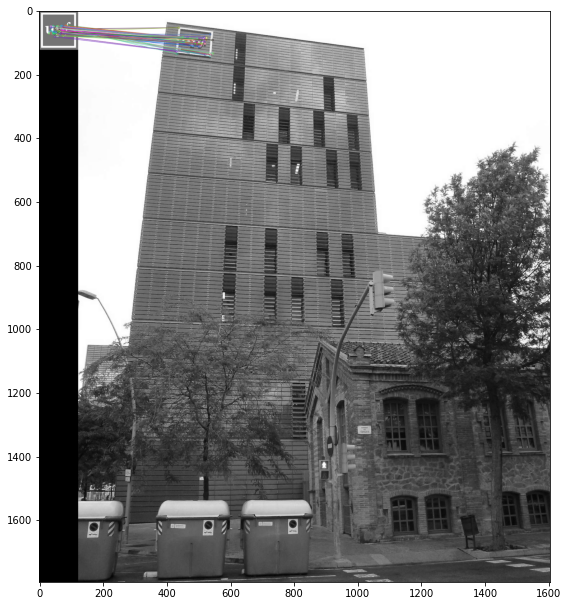

In [ ]:
# we use the x,y max and min to compute a mask 'building_mask', which will be the 
# region in which the keypoints will be computed
x_max = int(np.max(corners_logo_building_wrong[0,:]))
x_min = int(np.min(corners_logo_building_wrong[0,:]))
y_max = int(np.max(corners_logo_building_wrong[1,:]))
y_min = int(np.min(corners_logo_building_wrong[1,:]))

building_mask = np.zeros(shape=upf_building.shape, dtype=np.uint8)
building_mask[y_min:y_max, x_min:x_max] = 255

orb = cv2.ORB_create()
kp_logo, des_logo = orb.detectAndCompute(upf_logo,None)
kp_building, des_building = orb.detectAndCompute(upf_building, building_mask, None)

distance_thr = 0.99

# Keypoint matching
bf = cv2.BFMatcher()
matches_logo_building = bf.knnMatch(des_logo,des_building,k=2)
# Apply ratio test
good_matches_logo_building = []
for m,n in matches_logo_building:
    if m.distance < distance_thr*n.distance:
        good_matches_logo_building.append([m])

show_images_matches([upf_logo,kp_logo,upf_building,kp_building,good_matches_logo_building])

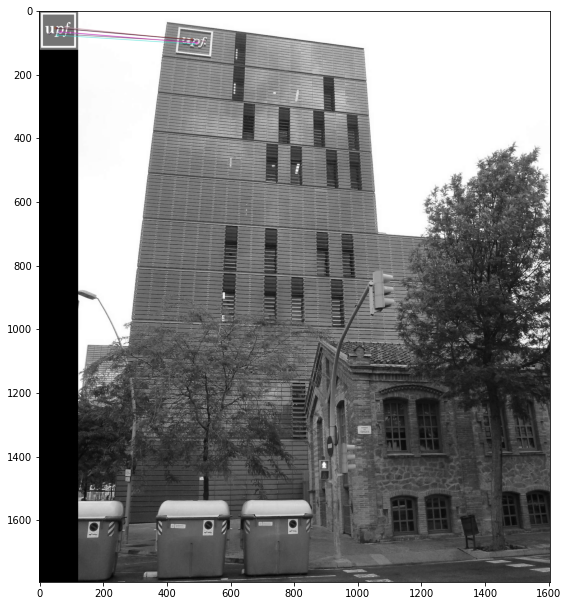

In [ ]:
# now we can use the keypoints to estimate the new H
points_logo, points_building, H_building_new, indices_inlier_matches_logo_building = estimate_homography_inliers(kp_logo,
                                                                                                                 kp_building,
                                                                                                                 good_matches_logo_building)

inlier_matches_logo_building = itemgetter(*indices_inlier_matches_logo_building)(good_matches_logo_building)

# show the inliers
show_images_matches([upf_logo,kp_logo,upf_building,kp_building,inlier_matches_logo_building])

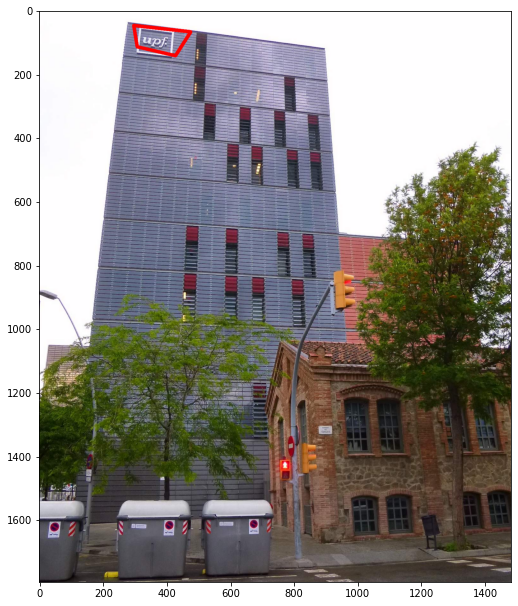

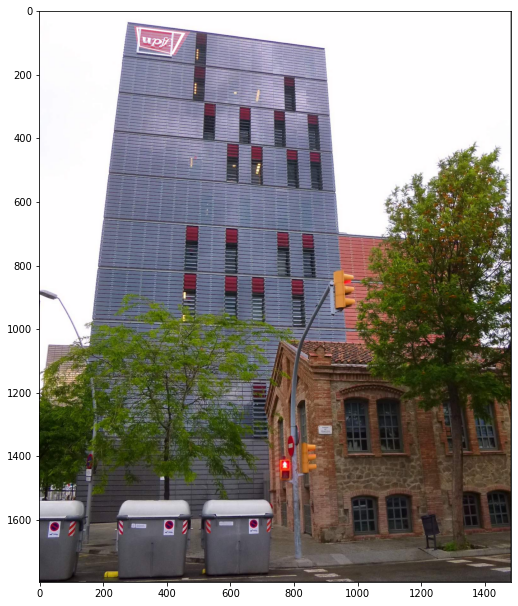

In [ ]:
# finally, we estimate the corners of the upf logo in the building image 
# using the new estimated homography to check if the results are better
corners_logo_building_h_new = H_building_new @ corners_logo_img
corners_logo_building_h_new = np.transpose(corners_logo_building_h_new[:2,:]/corners_logo_building_h_new[2,:])

upf_building_c_detected_new = cv2.polylines(np.copy(upf_building_c), 
                                            [corners_logo_building_h_new.reshape(-1,1,2).astype('int32')], 
                                            isClosed=True, color=(255,0,0), thickness=10)

plot_img(upf_building_c_detected_new)
fig = matplotlib.pyplot.gcf()
fig.set_size_inches(18.5, 10.5)

create_mosaic_logo(upf_logo_c, upf_building_c, H_building_new, corners_canvas)

<span style='color:Blue'> The result is better but not satisfactory, so let's try it using SIFT:  </span>

# <span style='color:Blue'> NI AMB SIFT NI AMB REFINEMENT MILLORA (NO WORRIES PERQUÈ AIXÒ ÉS UN OPCIONAL DE L'OPCIONAL, PERÒ M'EXTRANYA QUE NO MILLORI RES AMB EL REFINEMENT....) </span>

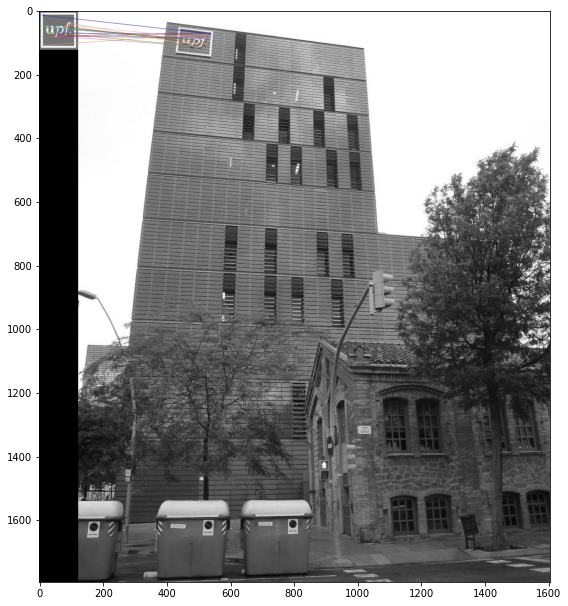

In [ ]:
SIFTdetector = cv2.xfeatures2d.SIFT_create(nfeatures=600)
kp_logo, des_logo = SIFTdetector.detectAndCompute(upf_logo, None)
kp_building, des_building = SIFTdetector.detectAndCompute(upf_building, building_mask, None)

distance_thr = 0.9

# Keypoint matching
bf = cv2.BFMatcher()
matches_logo_building = bf.knnMatch(des_logo,des_building,k=2)
# Apply ratio test
good_matches_logo_building_sift = []
for m,n in matches_logo_building:
    if m.distance < distance_thr*n.distance:
        good_matches_logo_building_sift.append([m])

show_images_matches([upf_logo,kp_logo,upf_building,kp_building,good_matches_logo_building_sift])

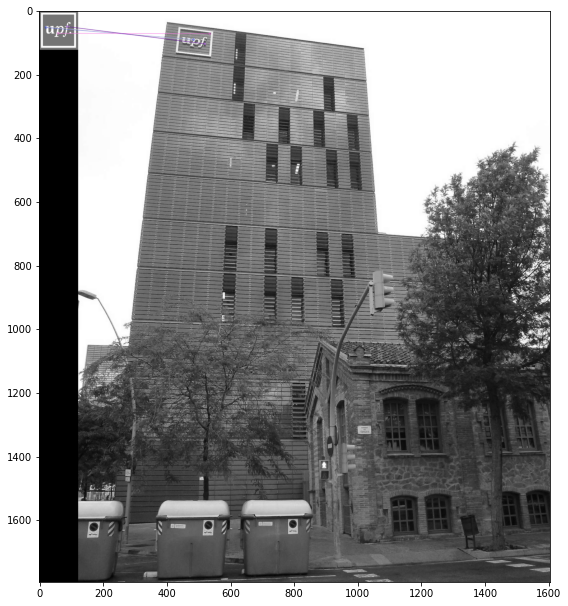

In [ ]:
# now we can use the keypoints to estimate the new H
_, _, H_building_sift, indices_inlier_matches_logo_building_sift = estimate_homography_inliers(kp_logo,
                                                                                               kp_building,
                                                                                               good_matches_logo_building_sift)

inlier_matches_logo_building_sift = itemgetter(*indices_inlier_matches_logo_building_sift)(good_matches_logo_building_sift)

# show the inliers
show_images_matches([upf_logo,kp_logo,upf_building,kp_building,inlier_matches_logo_building_sift])

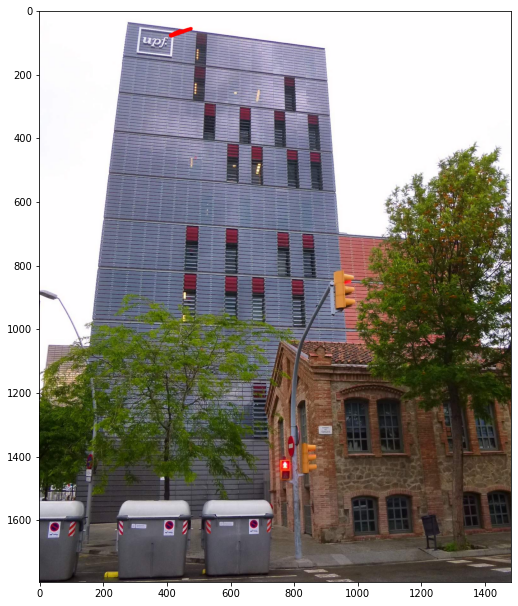

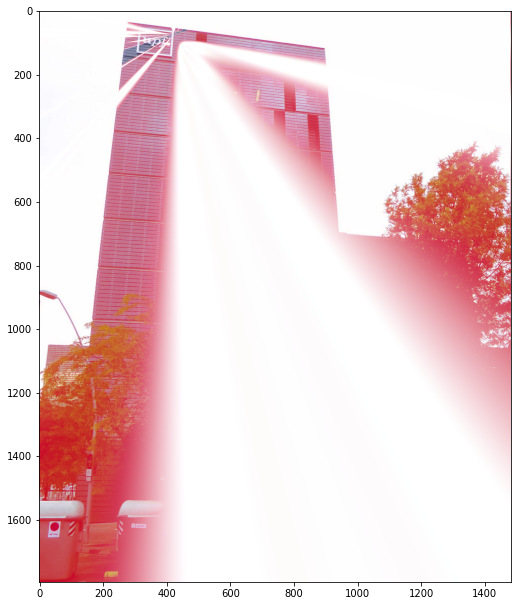

In [ ]:
# finally, we estimate the corners of the upf logo in the building image 
# using the new estimated homography to check if the results are better
corners_logo_building_h_new = H_building_sift @ corners_logo_img
corners_logo_building_h_new = np.transpose(corners_logo_building_h_new[:2,:]/corners_logo_building_h_new[2,:])

upf_building_c_detected_new = cv2.polylines(np.copy(upf_building_c), 
                                            [corners_logo_building_h_new.reshape(-1,1,2).astype('int32')], 
                                            isClosed=True, color=(255,0,0), thickness=10)

plot_img(upf_building_c_detected_new)
fig = matplotlib.pyplot.gcf()
fig.set_size_inches(18.5, 10.5)

create_mosaic_logo(upf_logo_c, upf_building_c, H_building_sift, corners_canvas)

<span style='color:Blue'> That didn't work, let's try to refine the homography:  </span>

In [ ]:
# inlier keypoints
points_logo_inl = points_logo[:,indices_inlier_matches_logo_building]
points_building_inl = points_building[:,indices_inlier_matches_logo_building]

# initial guess of the keypoint locations
points_logo_h_guess = np.linalg.inv(H_building_new) @ points_building_inl

# we want to refine the homography H and the keypoint locations
variables0 = np.concatenate([H_building_new.flatten(), points_logo_h_guess[:2,:].flatten()])

# data points: argument of the function 'geometric_error_terms'
points = [points_logo_inl[:2,:], points_building_inl[:2,:]]

result_logo_building = least_squares(geometric_error_terms, variables0, method='lm', args=([points]))
H_building_new_ref = result_logo_building.x[:9].reshape(3,3)

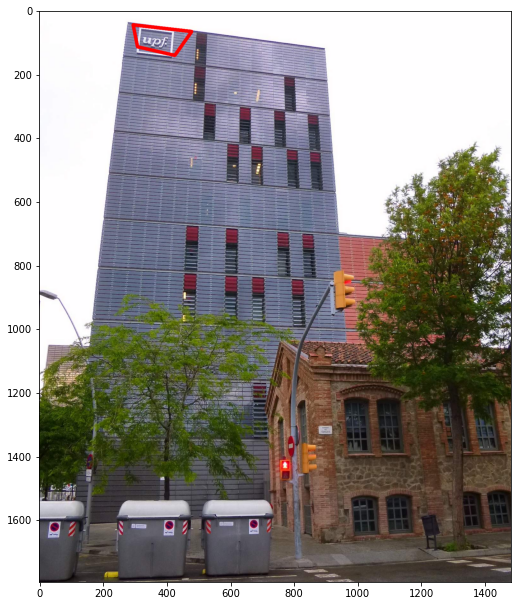

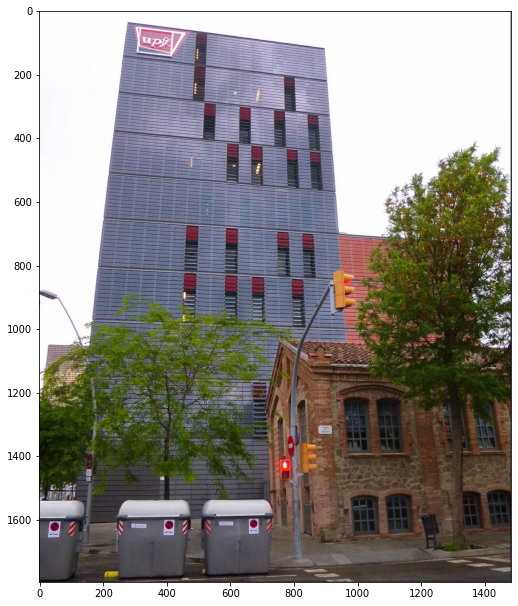

In [ ]:
# finally, we estimate the corners of the upf logo in the building image 
# using the new estimated homography to check if the results are better
corners_logo_building_h_new_ref = H_building_new_ref @ corners_logo_img
corners_logo_building_h_new_ref = np.transpose(corners_logo_building_h_new_ref[:2,:]/corners_logo_building_h_new_ref[2,:])

upf_building_c_detected_new_ref = cv2.polylines(np.copy(upf_building_c), 
                                                [corners_logo_building_h_new_ref.reshape(-1,1,2).astype('int32')], 
                                                isClosed=True, color=(255,0,0), thickness=10)

plot_img(upf_building_c_detected_new_ref)
fig = matplotlib.pyplot.gcf()
fig.set_size_inches(18.5, 10.5)

create_mosaic_logo(upf_logo_c, upf_building_c, H_building_new_ref, corners_canvas)

#### 5a - Manually selecting the four corners in the target image (UPF stand)

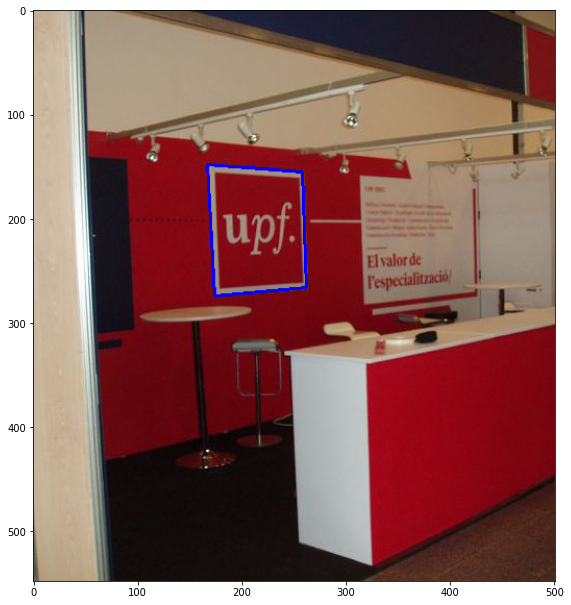

In [ ]:
# Image UPFStand
upf_stand = cv2.imread('Data/logos/UPFstand.jpg',cv2.IMREAD_GRAYSCALE)
upf_stand_c = cv2.imread('Data/logos/UPFstand.jpg',cv2.IMREAD_COLOR)
upf_stand_c = cv2.cvtColor(upf_stand_c, cv2.COLOR_BGR2RGB)

# manually selected corners of the upf logo in the stand image
corners_logo_stand = np.array([[168, 259, 263, 174], 
                               [148, 155, 267, 275],
                               [1, 1, 1, 1]])

# we can estimate the homography using the 4 correspondences
H_stand_manual = DLT_homography(corners_logo_img, corners_logo_stand)

# estimated corners of the upf logo in the stand image
corners_logo_stand_h = H_stand_manual @ corners_logo_img
corners_logo_stand_h = np.transpose(corners_logo_stand_h[:2,:]/corners_logo_stand_h[2,:])

upf_stand_c_detected = cv2.polylines(np.copy(upf_stand_c), 
                                    [corners_logo_stand_h.reshape(-1,1,2).astype('int32')], 
                                    isClosed=True, color=(0,0,255), thickness=2)
plot_img(upf_stand_c_detected)
fig = matplotlib.pyplot.gcf()
fig.set_size_inches(18.5, 10.5)

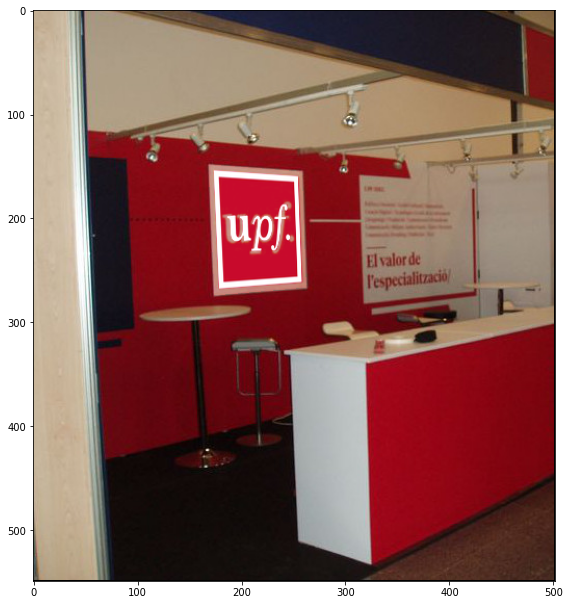

In [ ]:
# corners of the canvas where the mosaic will be created
corners_canvas = [0, upf_stand_c.shape[1], 0, upf_stand_c.shape[0]]

create_mosaic_logo(upf_logo_c, upf_stand_c, H_stand_manual, corners_canvas)

#### 5b - Automatically selecting the four corners in the target image (UPF building)

<span style='color:Blue'> As explained above, we cannot detect the logo automatically in the building image, as the keypoint matching is not accurate and thus the H is wrongly estimated: </span>

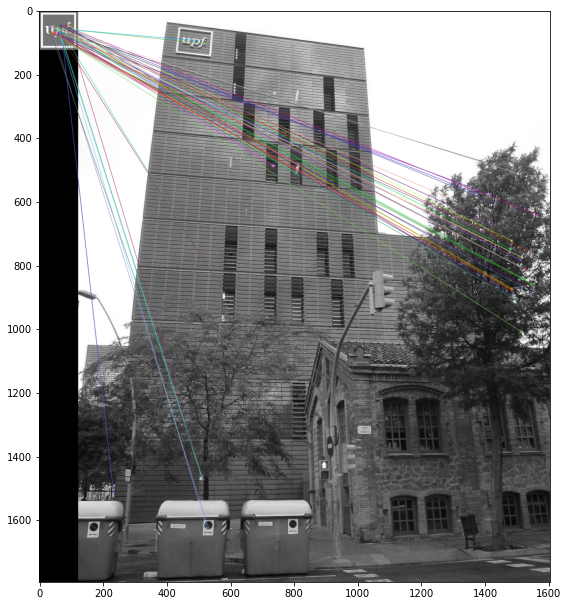

In [ ]:
kp_logo, kp_building, wrong_matches_logo_building = get_kp_matches(upf_logo,upf_building, distance_thr=0.95)

show_images_matches([upf_logo,kp_logo,upf_building,kp_building,wrong_matches_logo_building])

<span style='color:Blue'> If we try it with SIFT we get less mismatches but the homography is not correctly estimated either, as can be seen in the second plot (where the "inliers" are shown): </span>

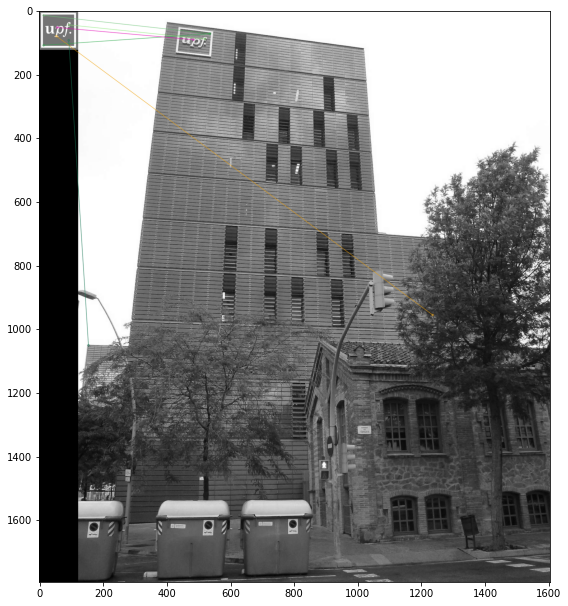

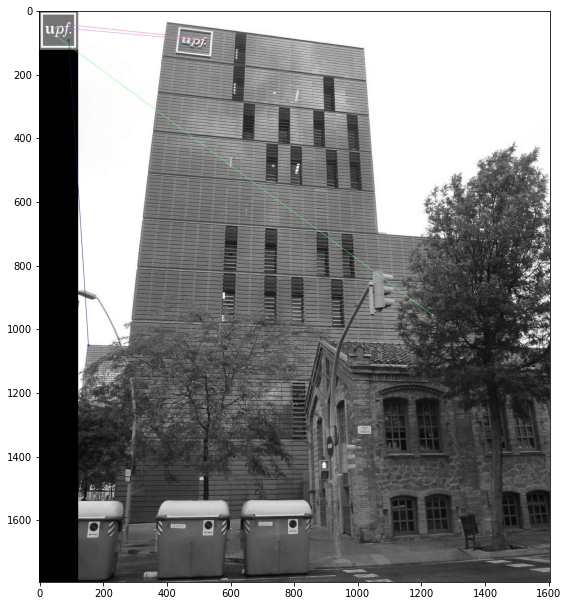

In [ ]:
SIFTdetector = cv2.xfeatures2d.SIFT_create(nfeatures=600)
kp_logo_sift, des_logo_sift = SIFTdetector.detectAndCompute(upf_logo, None)
kp_building_sift, des_building_sift = SIFTdetector.detectAndCompute(upf_building, None)

distance_thr = 0.8

# Keypoint matching
bf = cv2.BFMatcher()
matches_logo_building_sift = bf.knnMatch(des_logo_sift,des_building_sift,k=2)
# Apply ratio test
good_matches_logo_building_sift = []
for m,n in matches_logo_building_sift:
    if m.distance < distance_thr*n.distance:
        good_matches_logo_building_sift.append([m])

show_images_matches([upf_logo,kp_logo_sift,upf_building,kp_building_sift,good_matches_logo_building_sift])

# now we can use the keypoints to estimate the new H
_, _, _, indices_inlier_matches_logo_building_sift = estimate_homography_inliers(kp_logo_sift,
                                                                                kp_building_sift,
                                                                                good_matches_logo_building_sift)

inlier_matches_logo_building_sift = itemgetter(*indices_inlier_matches_logo_building_sift)(good_matches_logo_building_sift)

# show the inliers
show_images_matches([upf_logo,kp_logo_sift,upf_building,kp_building_sift,inlier_matches_logo_building_sift])

#### 5b - Automatically selecting the four corners in the target image (UPF stand)

<span style='color:Blue'> We can automatically detect the upf logo in the stand image, as most of the keypoint matches are accurate: </span>

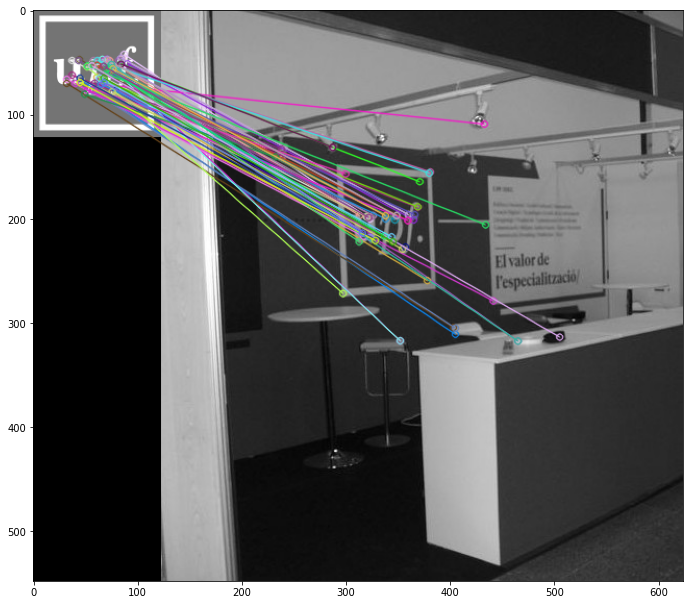

In [ ]:
# compute kp and matches
kp_logo, kp_stand, good_matches_logo_stand = get_kp_matches(upf_logo,upf_stand,distance_thr=0.95)

show_images_matches([upf_logo,kp_logo,upf_stand,kp_stand,good_matches_logo_stand])

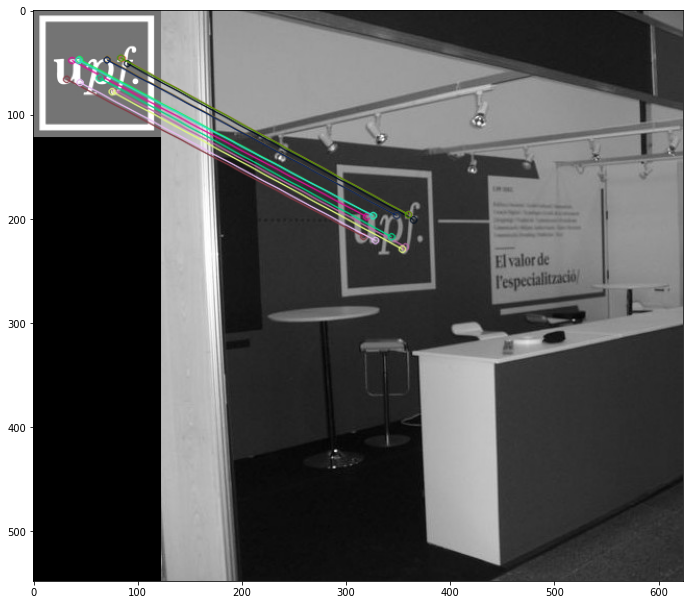

In [ ]:
# estimate H and show inliers
_, _, H_stand_auto, indices_inlier_matches_logo_stand = estimate_homography_inliers(kp_logo,
                                                                                    kp_stand,
                                                                                    good_matches_logo_stand)
inlier_matches_logo_stand = itemgetter(*indices_inlier_matches_logo_stand)(good_matches_logo_stand)

show_images_matches([upf_logo,kp_logo,upf_stand,kp_stand,inlier_matches_logo_stand])

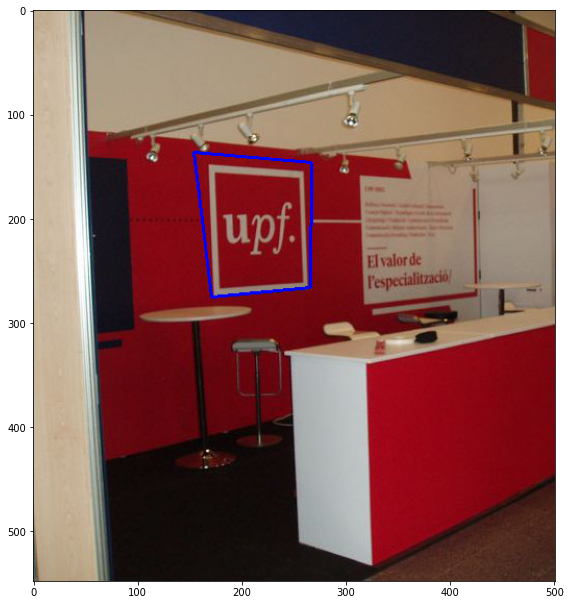

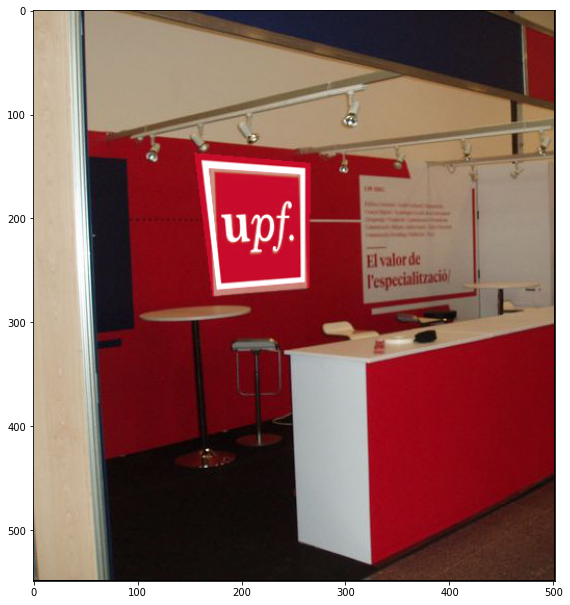

In [ ]:
# draw the logo contour and "insert" the image 'logoUPF' on the stand image

# estimated corners of the upf logo in the stand image
corners_logo_stand_h = H_stand_auto @ corners_logo_img
corners_logo_stand_h = np.transpose(corners_logo_stand_h[:2,:]/corners_logo_stand_h[2,:])

upf_stand_c_detected = cv2.polylines(np.copy(upf_stand_c), 
                                    [corners_logo_stand_h.reshape(-1,1,2).astype('int32')], 
                                    isClosed=True, color=(0,0,255), thickness=2)
plot_img(upf_stand_c_detected)
fig = matplotlib.pyplot.gcf()
fig.set_size_inches(18.5, 10.5)

# corners of the canvas where the mosaic will be created
corners_canvas = [0, upf_stand_c.shape[1], 0, upf_stand_c.shape[0]]

create_mosaic_logo(upf_logo_c, upf_stand_c, H_stand_auto, corners_canvas)

## **6. OPTIONAL. Application: Logo replacement**

<span style='color:Green'> - Replace the UPF logo by the master logo in one of the previous images using the DLT algorithm. </span>


#### 6a - UPF building

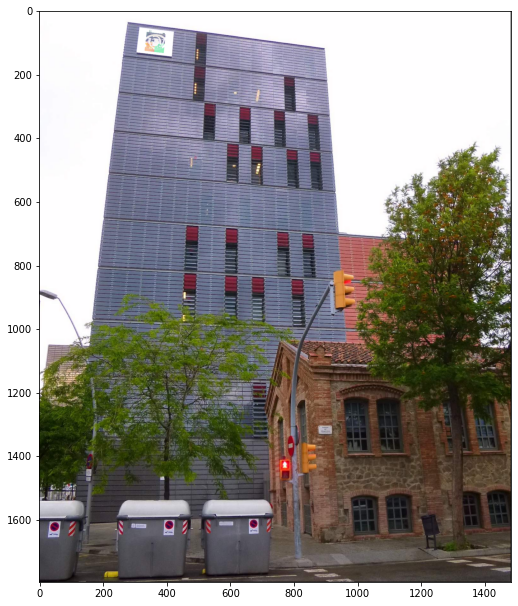

In [ ]:
# load the mcv logo and RESIZE it to the size of the upf logo
mcv_logo_c = cv2.imread('Data/logos/logo_master.png',cv2.IMREAD_COLOR)
mcv_logo_c = cv2.resize(mcv_logo_c, (upf_logo.shape[1],upf_logo.shape[0]))
mcv_logo_c = cv2.cvtColor(mcv_logo_c, cv2.COLOR_BGR2RGB)

# corners of the canvas where the mosaic will be created
corners_canvas = [0, upf_building.shape[1], 0, upf_building.shape[0]]

create_mosaic_logo(mcv_logo_c, upf_building_c, H_building_manual, corners_canvas)

#### 6b - UPF stand

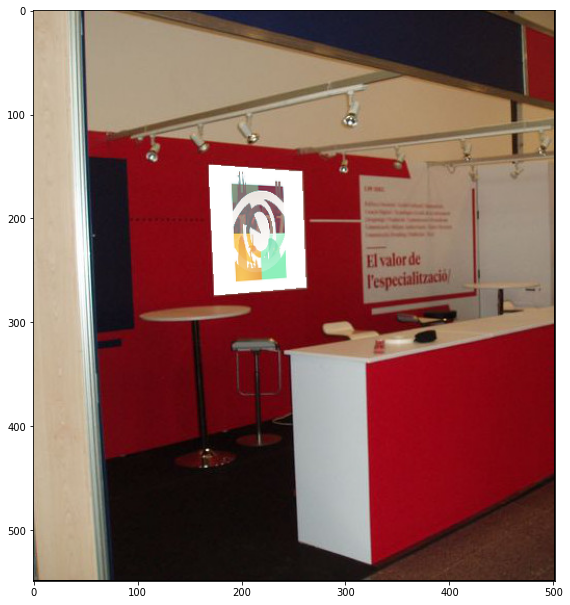

In [ ]:
# corners of the canvas where the mosaic will be created
corners_canvas = [0, upf_stand.shape[1], 0, upf_stand.shape[0]]

create_mosaic_logo(mcv_logo_c, upf_stand_c, H_stand_manual, corners_canvas)